In [ ]:
!pip install  pytorch-lightning torch-fidelity  torchvision==0.14.1 torchmetrics wandb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 825.8/825.8 KB 51.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 517.2/517.2 KB 49.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 71.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.9/178.9 KB 28.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 23.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 23.4 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8806 sha256=053414bd5c840de51926852cd1cd1552c5415707a438214d54d84940562faad4
  Stored in directory: /root/.cache/pip/wheels/4c/8e/7e/72fbc243e1aeecae64a96875432e70d4e92f3d2d18123be004
Successfully built pathtools
  At

In [ ]:
!pip install matplotlib pandas 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install "numpy<1.24.0" --user

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import torch
from torch import nn

# Import torchvision 
import torchvision
from torchvision import datasets
from torchvision.transforms import ToTensor , Lambda
# from torch.nn.utils import spectral_norm
from torch.nn.utils.parametrizations import spectral_norm
from torchmetrics.image.fid import FrechetInceptionDistance
# Import matplotlib for visualization
import matplotlib.pyplot as plt

# Check versions
# Note: your PyTorch version shouldn't be lower than 1.10.0 and torchvision version shouldn't be lower than 0.11
print(f"PyTorch version: {torch.__version__}\ntorchvision version: {torchvision.__version__}")

PyTorch version: 1.13.1+cu116
torchvision version: 0.14.1+cu116


In [ ]:

# def scaleTransform(x):return (x*2) -  1

# def scaleTransform(x):

filecontent = """
def scaleTransform(x):
    return (x*2) -  1
"""
with open('utils.py' , 'w') as f:
    f.write(filecontent)
from utils import scaleTransform

train_data = datasets.CIFAR10(
    root="data", # where to download data to?
    train=True, # get training data
    download=True, # download data if it doesn't exist on disk
    transform=torchvision.transforms.Compose([ToTensor(), Lambda(scaleTransform)]), # images come as PIL format, we want to turn into Torch tensors
    target_transform=None # you can transform labels as well
)

# Setup testing data


test_data = datasets.CIFAR10(
    root="data",
    train=False, # get test data
    download=True,
    transform=torchvision.transforms.Compose([ToTensor(),Lambda(scaleTransform) ]) 
)

from torch.utils.data import DataLoader

# Setup the batch size hyperparameter
BATCH_SIZE = 128

# Turn datasets into iterables (batches)
train_dataloader = DataLoader(train_data, # dataset to turn into iterable
    batch_size=BATCH_SIZE, # how many samples per batch? 
    shuffle=True , # shuffle data every epoch? , 
    num_workers=2, pin_memory=True
)

test_dataloader = DataLoader(test_data,
    batch_size=BATCH_SIZE,num_workers=2,pin_memory=True,
    shuffle=False # don't necessarily have to shuffle the testing data
)
# Let's check out what we've created
print(f"Dataloaders: {train_dataloader, test_dataloader}") 
print(f"Length of train dataloader: {len(train_dataloader)} batches of {BATCH_SIZE}")
print(f"Length of test dataloader: {len(test_dataloader)} batches of {BATCH_SIZE}")

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting data/cifar-10-python.tar.gz to data
Files already downloaded and verified
Dataloaders: (<torch.utils.data.dataloader.DataLoader object at 0x7fdd3e017490>, <torch.utils.data.dataloader.DataLoader object at 0x7fdd3df7ba00>)
Length of train dataloader: 391 batches of 128
Length of test dataloader: 79 batches of 128



### Conditional BatchNorm 
https://arxiv.org/pdf/1707.00683v3.pdf
- Normal Batchnorm are used to stablise gan training , thus making convergence faster
- Just like simple concatenation and using embedding layers at the start, 
- For Conditional BatchNorm, each class has its own weight and bias, and each class has its own value of beta and gamma


### Spectral Normalisation 
https://arxiv.org/pdf/1802.05957v1.pdf
- it is a weight normalisation technique that prevents vanishing/ exploding gradients, by rescaling the weight tensor with spectral norm σσ of the weight matrix
- It is an alternative to to using gradient penalty to enforce the 1-Lipschitz Continuity, thus another method to stablising the training
- It is computationally cheaper than gradient penalty, thus allowing better performance in shorter amount of training time
- Loss function : the Spectral Normalisation paper achieved best results with hinge loss, so I tried the hinge loss

### Hinge Loss 
https://arxiv.org/pdf/1705.02894.pdf
-  Based on support vector machines classifier
- The discriminator learns a boundry between real and fake samples, that the real and generated images are the furthest apart 
- The generator will generate images closer to the boundry found by the discrminator
- It is shown in paper that it increases stability and alliviates mode collaspe
- The "theoretical results" in the paper also shown that  Nash equilibrium between discriminator and generator is achieved (when none of the networks can make the other improve further)



In [ ]:


def init_weights(m):
    if isinstance(m, nn.Linear):
        
        try:
            torch.nn.init.xavier_uniform(m.weight)
            m.bias.data.fill_(0.01)
        except:
            pass


class BatchNorm2d(torch.nn.BatchNorm2d):
    def reset_parameters(self):
        self.reset_running_stats()
        if self.affine:
            self.weight.data.fill_(1.0)
            self.bias.data.zero_()


class CategoricalConditionalBatchNorm(torch.nn.Module):
    # as in the chainer SN-GAN implementation, we keep per-cat weight and bias
    def __init__(self, num_features, num_cats, eps=2e-5, momentum=0.1, affine=True,
                 track_running_stats=True):
        super().__init__()
        self.num_features = num_features
        self.num_cats = num_cats
        self.eps = eps
        self.momentum = momentum
        self.affine = affine
        self.track_running_stats = track_running_stats
        if self.affine:
            self.weight = torch.nn.Parameter(torch.Tensor(num_cats, num_features))
            self.bias = torch.nn.Parameter(torch.Tensor(num_cats, num_features))
        else:
            self.register_parameter('weight', None)
            self.register_parameter('bias', None)
        if self.track_running_stats:
            self.register_buffer('running_mean', torch.zeros(num_features))
            self.register_buffer('running_var', torch.ones(num_features))
            self.register_buffer('num_batches_tracked', torch.tensor(0, dtype=torch.long))
        else:
            self.register_parameter('running_mean', None)
            self.register_parameter('running_var', None)
            self.register_parameter('num_batches_tracked', None)
        self.reset_parameters()

    def reset_running_stats(self):
        if self.track_running_stats:
            self.running_mean.zero_()
            self.running_var.fill_(1)
            self.num_batches_tracked.zero_()

    def reset_parameters(self):
        self.reset_running_stats()
        if self.affine:
            self.weight.data.fill_(1.0)
            self.bias.data.zero_()

    def forward(self, input, cats):
        exponential_average_factor = 0.0

        if self.training and self.track_running_stats:
            self.num_batches_tracked += 1
            if self.momentum is None:  # use cumulative moving average
                exponential_average_factor = 1.0 / self.num_batches_tracked.item()
            else:  # use exponential moving average
                exponential_average_factor = self.momentum

        out = torch.nn.functional.batch_norm(
            input, self.running_mean, self.running_var, None, None,
            self.training or not self.track_running_stats,
            exponential_average_factor, self.eps)
        if self.affine:
            shape = [input.size(0), self.num_features] + (input.dim() - 2) * [1]
            weight = self.weight.index_select(0, cats).view(shape)
            bias = self.bias.index_select(0, cats).view(shape)
            out = out * weight + bias
        return out

    def extra_repr(self):
        return '{num_features}, num_cats={num_cats}, eps={eps}, momentum={momentum}, affine={affine}, ' \
               'track_running_stats={track_running_stats}'.format(**self.__dict__)

def get_children(model: torch.nn.Module):
    # get children form model!
    children = list(model.children())
    flatt_children = []
    if children == []:
        # if model has no children; model is last child! :O
        return model
    else:
       # look for children from children... to the last child!
       for child in children:
            try:
                flatt_children.extend(get_children(child))
            except TypeError:
                flatt_children.append(get_children(child))
    return flatt_children

# class Resnet_Block(nn.Module):
#     def __init__(self,filters,bn = True):
#         super().__init__() 
        
#         # for _ in range(2):
        
#         self.bn1 =     CategoricalConditionalBatchNorm(filters , 10) 
#         layers = []
#         layers.append(nn.ReLU())
#         layers.append( (nn.LazyConv2d(filters, 3, padding ='same')))
#         self.sequentialbranch1 = nn.Sequential(*layers)

#         self.bn2 =     CategoricalConditionalBatchNorm(filters , 10) 
#         layers = []
#         layers.append(nn.ReLU())
#         layers.append( (nn.LazyConv2d(filters, 3, padding ='same')))

#         self.sequentialbranch2 = nn.Sequential(*layers)

#     def forward(self, x ,y):
#         skip =  x
#         x = self.bn1(x,y)
#         x = self.sequentialbranch1(x)
#         x = self.bn2(x,y)
#         x = self.sequentialbranch2(x)
#         return skip + x 

class Resnet_Block(nn.Module):
    def __init__(self,filters,bn = True):
        super().__init__() 
        layers = []
        for _ in range(2):
            if bn:
                layers.append(nn.CategoricalConditionalBatchNorm(filters , 10) )
            layers.append(nn.ReLU())
            layers.append( (nn.LazyConv2d(filters, 3, padding ='same')))
            self.sequentialbranch = nn.Sequential(*layers)

    def forward(self, x):
        return self.sequentialbranch(x) + x 

class Resnet_Block_down(nn.Module):
    def __init__(self,filters,bn = True):
        super().__init__() 

        layers = []
        if bn:
            layers.append(CategoricalConditionalBatchNorm(filters , 10) )
        layers.append(nn.ReLU())
        layers.append( (nn.LazyConv2d(filters, 3, padding ='same')))
        if bn:
            layers.append(CategoricalConditionalBatchNorm(filters , 10) )
        layers.append(nn.ReLU())
        layers.append( (nn.LazyConv2d(filters, 3, padding ='same')))
        layers.append(nn.AvgPool2d(2 , 2))
        self.mainbranch = nn.Sequential(*layers)
        self.sidebranch = nn.Sequential( (nn.LazyConv2d(filters, 3, padding ='same')) , 
                                         nn.AvgPool2d(2 , 2))
        

    def forward(self, x):
        return self.mainbranch(x) + self.sidebranch(x) 
        

class Resnet_Block_up(nn.Module):
    def __init__(self,filters,bn = True):
        super().__init__() 

       
        
        self.bn1 =    CategoricalConditionalBatchNorm(filters , 10) 
        layers = []
        layers.append(nn.ReLU())
        layers.append( nn.Upsample(scale_factor=2))
        layers.append( (nn.LazyConv2d(filters, 3, padding ='same')))
        self.mainbranch1 = nn.Sequential(*layers)
        self.bn2 =CategoricalConditionalBatchNorm(filters , 10)
        layers = []
        layers.append(nn.ReLU())
        layers.append( (nn.LazyConv2d(filters, 3, padding ='same')))
        self.mainbranch2 =  nn.Sequential(*layers)

        # self.mainbranch = nn.Sequential(*layers)
        self.sidebranch = nn.Sequential( nn.Upsample(scale_factor=2)  ,  nn.LazyConv2d(filters, 1, padding ='same') )

    def forward(self, x, y):
        skip = x
        x= self.bn1(x, y)
        x = self.mainbranch1(x)
        x= self.bn2(x,y)
        x = self.mainbranch2(x)

        return x  + self.sidebranch(skip) 
        

class Resnet_Discriminator(nn.Module):
    def __init__(self):
        super().__init__()

        self.class_processing = nn.Sequential(nn.Embedding(10 , 50 ), nn.LazyLinear( 32*32))
 

        self.initial_block_main = nn.Sequential(
            nn.LazyConv2d( 128, 3, padding ='same') , 
            nn.ReLU() , 
            (nn.LazyConv2d(128, 3, padding ='same')) ,
            nn.AvgPool2d(2 , 2), 
        )

        self.initial_block_side = nn.Sequential(
            nn.AvgPool2d(2 , 2),
            ( nn.LazyConv2d( 128, 3, padding ='same'))
        )

        self.main_blocks = nn.Sequential(
            Resnet_Block_down( 128 , False),
            Resnet_Block(128, False),
            Resnet_Block(128, False)

        )


        self.final = nn.Sequential( 
            nn.ReLU(), 
            nn.AdaptiveMaxPool2d(output_size=1), 
            nn.Flatten() , 
            
        )
        self.class_embed = spectral_norm(nn.Embedding(10, 128))


        self.finallinear = nn.LazyLinear( 1  )

        
        _ = self(torch.randn(128,3,32,32) , torch.randint(high = 10, size = (128,)))

        self.apply(init_weights)

        for child in get_children(self):
            if  isinstance(child , nn.LazyConv2d ) or isinstance(child , nn.Conv2d ) or isinstance( child,( nn.Linear , nn.LazyLinear)):
                child = spectral_norm(child)


        

    def forward(self, x , y):
        y= torch.reshape(self.class_processing( y), [-1, 1,32,32])  
        concated= torch.cat(  (x,y) , dim = 1 ) 
        x = self.initial_block_main(x) + self.initial_block_side(x)
        x = self.main_blocks(x)
        x= self.final(x)
        out = self.finallinear(x)

        # x += torch.sum(self.class_embed(y) * x, dim=1, keepdim=True)

        return out 


class Resnet_Generator(nn.Module):
    def __init__(self):
        super().__init__() 

        self.initial_linear = nn.Linear( 128, 4*4*128)
        # self.class_processing = nn.Sequential(nn.Embedding(10 , 50 ), nn.LazyLinear(4*4))


        self.main_blocks = nn.ModuleList(
            [Resnet_Block_up( 128 , True),
            Resnet_Block_up(128, True),
            Resnet_Block_up(128, True)]
        )

        self.final = nn.Sequential( 
            nn.LazyBatchNorm2d() , 
            nn.ReLU(),
            nn.LazyConv2d( 3, 3, padding ='same'),
            nn.Tanh()
        )
        
        _ = self(torch.randn(128,128) , torch.randint(high = 10, size = (128,)))
        self.apply(init_weights)



        for child in get_children(self):
            if  isinstance(child , (nn.LazyConv2d , nn.Conv2d, nn.LazyLinear) )  :
                child = spectral_norm(child)

    def forward(self, x,y):
        x = self.initial_linear(x) 
        x = torch.reshape( x , [-1, 128, 4,4])
        # y = torch.reshape( self.class_processing(y), [-1,1, 4,4 ] )
        # concat = torch.cat( ( x,y) ,dim =1 )
        # x = self.main_blocks(x)
        for block in self.main_blocks:
            x = block(x,y)

        x = self.final(x)

        if not self.training:
            # to generate images to calculate kid/fid
            x = 255 * (x.clamp(-1, 1) * 0.5 + 0.5)
            x = x.to(torch.uint8)
        return x



# test_dis= Resnet_Discriminator()
# test_gen = Resnet_Generator() 
# # with torch.no_grad():
#     outputs = test_gen(torch.randn( 128 , 128 ))
# import numpy as np 
# model_parameters = filter(lambda p: p.requires_grad, test_gen.parameters())
# params = sum([np.prod(p.size()) for p in  test_gen.parameters()])

In [ ]:
from pytorch_lightning.core import LightningModule
from pytorch_lightning.trainer import Trainer
import torch_fidelity
import numpy as np 
import collections 
import torchmetrics
torch.manual_seed(1)


def hinge_loss(dpred_real,dpred_fake ):
    return (-torch.minimum(torch.tensor(0.0, dtype=torch.float, device=dpred_real.device),dpred_real - 1.0,).mean()
        - 
        torch.minimum(torch.tensor(0.0, dtype=torch.float, device=dpred_fake.device),-dpred_fake - 1.0,).mean())
    
import shutil, os

def discriminator_loss(dpred_real,dpred_fake):
    return hinge_loss(dpred_real,dpred_fake)
    
def generator_loss(pred):
    return -torch.mean(pred)
class GAN(LightningModule):

    def __init__(self,
                 discriminator , 
                 generator, 
                 dataloader,
                 val_data,
                 d_loss,
                 g_loss,
                 latent_dim: int = 128,
                 lr: float = 0.0002,
                 b1: float = 0.3,
                 b2: float = 0.999,
                 batch_size: int = 128 ,
                 n_discriminator_updates = 1,
                 metricfreq = 5,
                 **kwargs):
        super().__init__()
        self.data = dataloader
        self.n_discriminator_updates = n_discriminator_updates
        self.val_data = val_data
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.lr = lr
        self.b1 = b1
        self.b2 = b2
        self.batch_size = batch_size
        self.g_loss = g_loss
        self.d_loss = d_loss
        self.epoch_counter = self.current_epoch
        self.metrics = collections.defaultdict(list)
        self.validation_z = torch.randn(8, self.latent_dim)
        self.example_input_array = torch.zeros(2, self.latent_dim)
        self.automatic_optimization = False
        self.metricsfreq = metricfreq
        self.d_loss_epoch =[]
        self.g_loss_epoch =[]
        self.kid = torchmetrics.image.kid.KernelInceptionDistance(subset_size = 128) 
    def forward(self, *z):
        return self.generator(*z)
    def training_step(self, batch, batch_idx):
        imgs, labels= batch
        imgs.requires_grad = True
        # imgs = scaleTransform(imgs)

        g_opt, d_opt = self.optimizers()


        # sample noise
        z = torch.randn(imgs.shape[0], self.latent_dim)
        z = z.type_as(imgs)


        # train generator

        # gen erate images
        if batch_idx % self.n_discriminator_updates == 0:
            # self.generated_imgs = self(z)

            # # log sampled images
            # sample_imgs = self.generated_imgs[:6]
            # grid = torchvision.utils.make_grid(sample_imgs)
            # self.logger.experiment.add_image('generated_images', grid, 0)

            # ground truth result (ie: all fake)
            # put on GPU because we created this tensor inside training_loop
            # valid = torch.ones(imgs.size(0), 1)
            # valid = valid.type_as(imgs)

            # adversarial loss is binary cross-entropy
            pred_false = generator_loss(self.discriminator(self(z, labels),labels))

            g_loss = (pred_false)

                
            g_opt.zero_grad()
            self.manual_backward(g_loss)
            g_opt.step()
            self.g_loss = g_loss
            # self.g_loss_epoch.append(g_loss.item())


    # train discriminator
    # Measure discriminator's ability to classify real from generated samples
        fake_img = self(z, labels)
        realpred = self.discriminator(imgs , labels)
        fakepred = self.discriminator(fake_img,labels)
        d_loss = discriminator_loss( realpred,fakepred  )  
        
        d_opt.zero_grad()
        self.manual_backward(d_loss)
        d_opt.step()
        self.log('g_loss', self.g_loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.log('d_loss', d_loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        # self.log_dict({"g_loss": self.g_loss, "d_loss": d_loss}, prog_bar=True)
        
        # self.d_loss_epoch.append(d_loss.item())

    

    def configure_optimizers(self):
        # n_critic = 5

        lr = self.lr
        b1 = self.b1
        b2 = self.b2

        opt_g = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(b1, b2))
        opt_d = torch.optim.Adam(self.discriminator.parameters(), lr=lr, betas=(b1, b2))
        return opt_g, opt_d 
    
    def scaleTransform(self,x):
        return (x*2) -  1

    def train_dataloader(self):
        return self.data
    def val_dataloader(self):
        return self.val_data

    def validation_step(self, b, bid):
        img,labels = b 
        z = torch.randn(img.shape[0], self.latent_dim)
        z = z.type_as(img)
        fakes = self( z, labels)
        # fakes = 255*((fakes+1)/2)
        reals = 255*((img+1)/2)

        self.kid.update(reals.to(torch.uint8), True)

        self.kid.update(fakes, False)




        

    def validation_epoch_end(self,batch):
        # print('validate')
        # if self.current_epoch % self.metricsfreq:
    
        # wrapped_generator = torch_fidelity.GenerativeModelModuleWrapper(self.generator, self.latent_dim, 'normal', 10)

        # metrics = torch_fidelity.calculate_metrics(
        #     input1=wrapped_generator, 
        #     input2='cifar10-val', 
        #     input1_model_num_samples = 10000, #size of cifar10 validation set
        #     cuda=True, 
        #     isc=False, 
        #     fid=False, 
        #     kid=True, 
        #     verbose=False,
        # )
        # metrics = {'kernel_inception_distance_mean' : 1}
        # mean_d_loss= np.mean(self.d_loss_epoch)
        # mean_g_loss= np.mean(self.g_loss_epoch)
        # self.d_loss_epoch.clear()
        # self.g_loss_epoch.clear()
        kid,_ = self.kid.compute()
        self.kid.reset()

        self.log( "kid", kid , prog_bar=True, logger=True)



        

        metricdict = {"epoch" : self.current_epoch, "kid":  kid }
        # self.log_dict(metricdict, prog_bar=False)
        # wandb.log(metricdict)

        # for key , value in metricdict.items():
        #     self.metrics[key].append(value )
        print(metricdict)

            
        disstr = f"Discriminator-Epoch{self.current_epoch},KID={kid}.pth"
        genstr = f"Generator-Epoch{self.current_epoch},KID={kid}.pth"

            
        # self.discriminator.save(disstr,save_format="tf")
        # self.generator.save(genstr	, save_format="tf")
        torch.save(self.discriminator.state_dict(),disstr )
        torch.save(self.generator.state_dict(),genstr )
        # self.model.save(self.filepath[:-3], overwrite=True, save_format="tf")

        # Log the model as artifact.
        dis_name = wandb.util.make_artifact_name_safe(f"Discriminator-{wandb.run.name}")
        gen_name = wandb.util.make_artifact_name_safe(f"Generator-{wandb.run.name}")
        dis_artifact = wandb.Artifact(dis_name, type="model")
        gen_artifact = wandb.Artifact(gen_name, type="model")



        dis_artifact.add_file(disstr)
        gen_artifact.add_file(genstr)
        wandb.run.log_artifact(dis_artifact, aliases=["latest", f"Discriminator_epoch_{self.current_epoch}"])
        wandb.run.log_artifact(gen_artifact, aliases=["latest", f"Generator_epoch_{self.current_epoch}"])

        # Remove the SavedModel from wandb dir as we don't want to log it to save memory.
        os.remove(disstr)
        os.remove(genstr)


    def training_epoch_end(self , data):
        # z = self.validation_z.to(self.device)
        num_cols =10
        num_rows=5

        random_latent_vectors = torch.randn(num_cols * num_rows, self.latent_dim).cuda() 
        generated_images = self.generator(random_latent_vectors,  torch.arange(0,10).repeat_interleave(5).type(torch.IntTensor).cuda()  ).cpu().detach().numpy()


        generated_images = (generated_images +1 ) /2 




        images = []
  


        plt.figure(figsize=(num_cols * 1.0, num_rows * 1.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(np.transpose(generated_images[index] , (1,2,0)))
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()


        # log sampled images
        # sample_imgs = self(z)
        # grid = torchvision.utils.make_grid(sample_imgs)
        # self.logger.experiment.add_image('generated_images', grid, self.current_epoch)

from pytorch_lightning.callbacks import TQDMProgressBar,Callback

class MetricTracker(Callback):

  def __init__(self):
    self.collection = collections.defaultdict(list)

  def on_train_epoch_end(self, trainer, ganmodule):
    elogs = trainer.logged_metrics
    print('logs' , elogs)
    self.collection['epoch'].append(ganmodule.current_epoch)
    self.collection['d_loss'].append(elogs['d_loss_epoch'].item())
    self.collection['g_loss'].append(elogs['g_loss_epoch'].item())
    d ={}
    for k,v in self.collection.items():
      d[k] = v[-1]
    wandb.log(d)
  def on_validation_epoch_end(self,trainer, module):
    self.collection['kid'].append(trainer.logged_metrics['kid'].item())
    


### I used incremental fit as colab is unable to run 100 epoch in one go, hence, training is spread out across 2 cells, 57 epoch in first cell and 41 epoch in second cell 

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


/usr/local/lib/python3.8/dist-packages/torch/nn/modules/lazy.py:180: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '
<ipython-input-6-ea75c2fc438e>:5: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  torch.nn.init.xavier_uniform(m.weight)
/usr/local/lib/python3.8/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Metric `Kernel Inception Distance` will save all extracted features in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)
/usr/local/lib/python3.8/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:467: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  rank_zero_deprecation(


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

{'epoch': 0, 'kid': tensor(0.1365, device='cuda:0')}


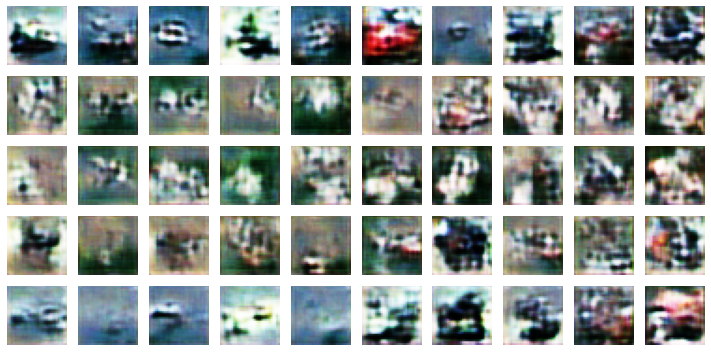

logs {'g_loss_step': tensor(-0.1959, device='cuda:0'), 'd_loss_step': tensor(2.0283, device='cuda:0'), 'kid': tensor(0.1365, device='cuda:0'), 'g_loss_epoch': tensor(0.3083, device='cuda:0'), 'd_loss_epoch': tensor(1.9722, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 1, 'kid': tensor(0.1073, device='cuda:0')}


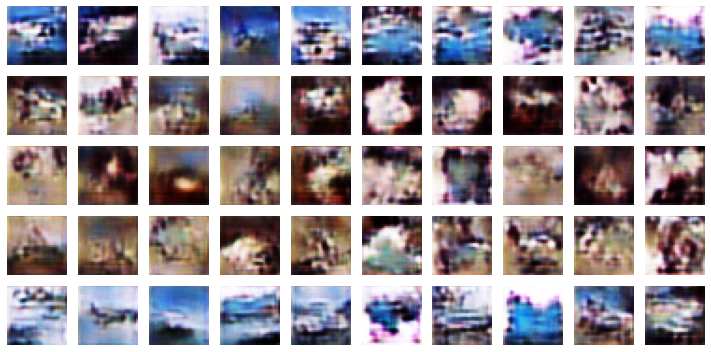

logs {'g_loss_step': tensor(0.2802, device='cuda:0'), 'd_loss_step': tensor(2.1386, device='cuda:0'), 'kid': tensor(0.1073, device='cuda:0'), 'g_loss_epoch': tensor(0.0723, device='cuda:0'), 'd_loss_epoch': tensor(2.0000, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 2, 'kid': tensor(0.1025, device='cuda:0')}


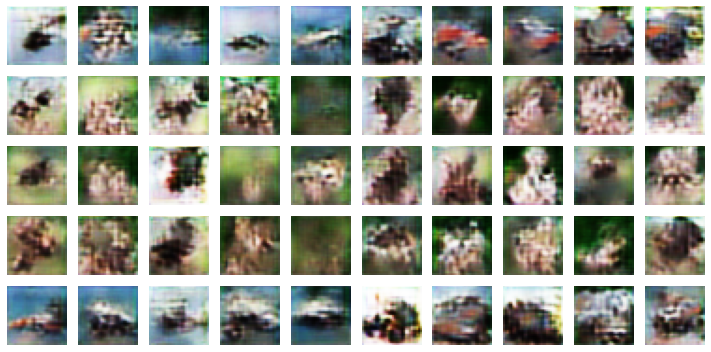

logs {'g_loss_step': tensor(-0.0060, device='cuda:0'), 'd_loss_step': tensor(2.0205, device='cuda:0'), 'kid': tensor(0.1025, device='cuda:0'), 'g_loss_epoch': tensor(0.0590, device='cuda:0'), 'd_loss_epoch': tensor(2.0010, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 3, 'kid': tensor(0.0687, device='cuda:0')}


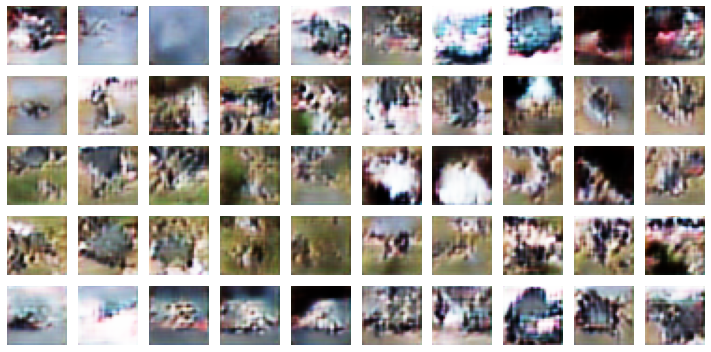

logs {'g_loss_step': tensor(0.3351, device='cuda:0'), 'd_loss_step': tensor(2.0473, device='cuda:0'), 'kid': tensor(0.0687, device='cuda:0'), 'g_loss_epoch': tensor(0.0539, device='cuda:0'), 'd_loss_epoch': tensor(1.9974, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 4, 'kid': tensor(0.0820, device='cuda:0')}


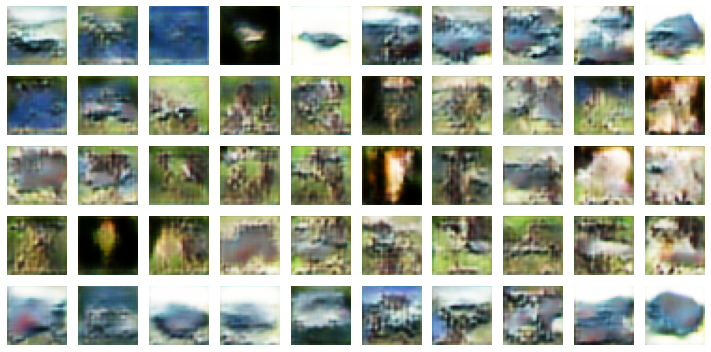

logs {'g_loss_step': tensor(0.0711, device='cuda:0'), 'd_loss_step': tensor(2.0664, device='cuda:0'), 'kid': tensor(0.0820, device='cuda:0'), 'g_loss_epoch': tensor(0.0917, device='cuda:0'), 'd_loss_epoch': tensor(1.9963, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 5, 'kid': tensor(0.0651, device='cuda:0')}


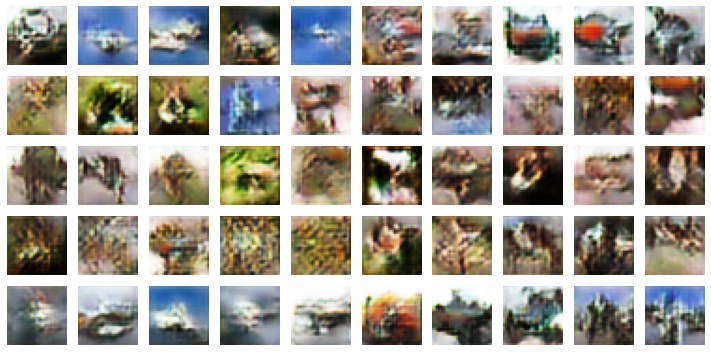

logs {'g_loss_step': tensor(-0.0688, device='cuda:0'), 'd_loss_step': tensor(2.0091, device='cuda:0'), 'kid': tensor(0.0651, device='cuda:0'), 'g_loss_epoch': tensor(0.0267, device='cuda:0'), 'd_loss_epoch': tensor(2.0003, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 6, 'kid': tensor(0.0544, device='cuda:0')}


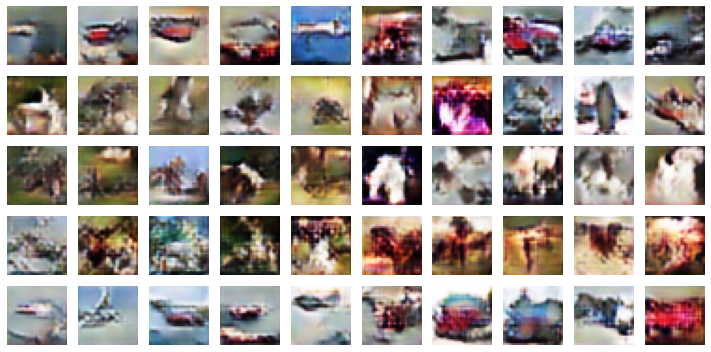

logs {'g_loss_step': tensor(-0.0810, device='cuda:0'), 'd_loss_step': tensor(1.9805, device='cuda:0'), 'kid': tensor(0.0544, device='cuda:0'), 'g_loss_epoch': tensor(0.0029, device='cuda:0'), 'd_loss_epoch': tensor(1.9998, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 7, 'kid': tensor(0.0606, device='cuda:0')}


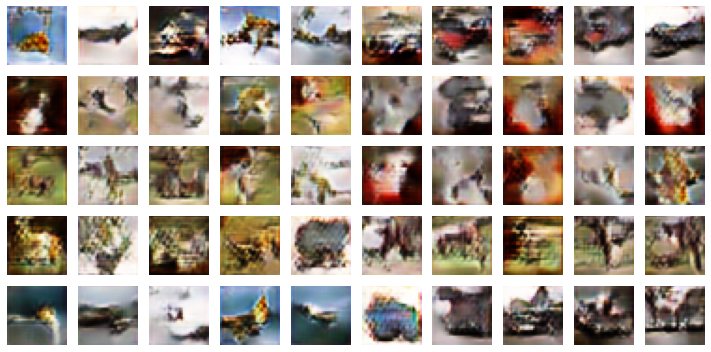

logs {'g_loss_step': tensor(0.1264, device='cuda:0'), 'd_loss_step': tensor(2.0118, device='cuda:0'), 'kid': tensor(0.0606, device='cuda:0'), 'g_loss_epoch': tensor(0.0031, device='cuda:0'), 'd_loss_epoch': tensor(2.0021, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 8, 'kid': tensor(0.0572, device='cuda:0')}


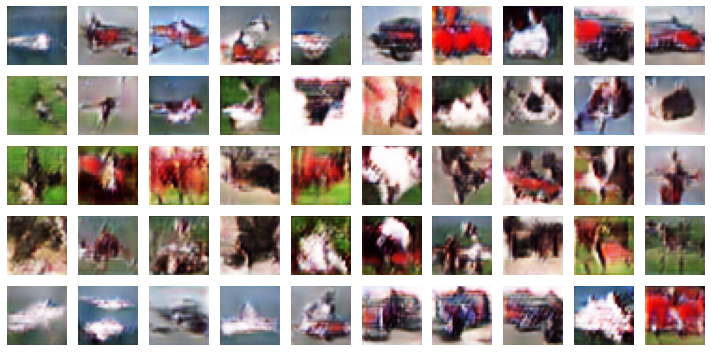

logs {'g_loss_step': tensor(-0.0716, device='cuda:0'), 'd_loss_step': tensor(2.0430, device='cuda:0'), 'kid': tensor(0.0572, device='cuda:0'), 'g_loss_epoch': tensor(0.0447, device='cuda:0'), 'd_loss_epoch': tensor(2.0011, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 9, 'kid': tensor(0.0507, device='cuda:0')}


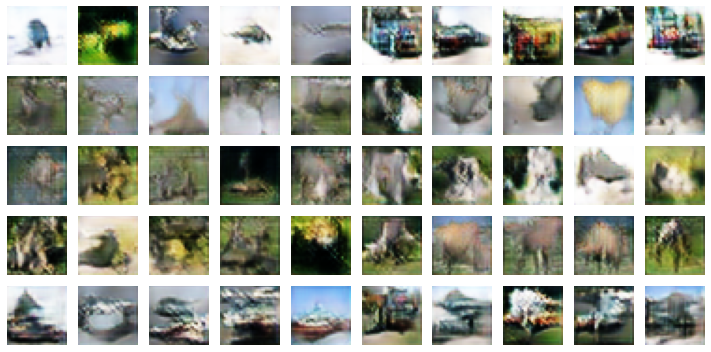

logs {'g_loss_step': tensor(-0.1061, device='cuda:0'), 'd_loss_step': tensor(2.0219, device='cuda:0'), 'kid': tensor(0.0507, device='cuda:0'), 'g_loss_epoch': tensor(0.0182, device='cuda:0'), 'd_loss_epoch': tensor(2.0014, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 10, 'kid': tensor(0.0523, device='cuda:0')}


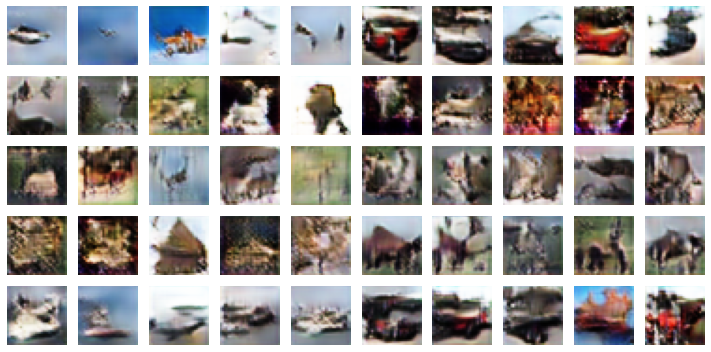

logs {'g_loss_step': tensor(0.0605, device='cuda:0'), 'd_loss_step': tensor(2.0044, device='cuda:0'), 'kid': tensor(0.0523, device='cuda:0'), 'g_loss_epoch': tensor(0.0261, device='cuda:0'), 'd_loss_epoch': tensor(2.0018, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 11, 'kid': tensor(0.0535, device='cuda:0')}


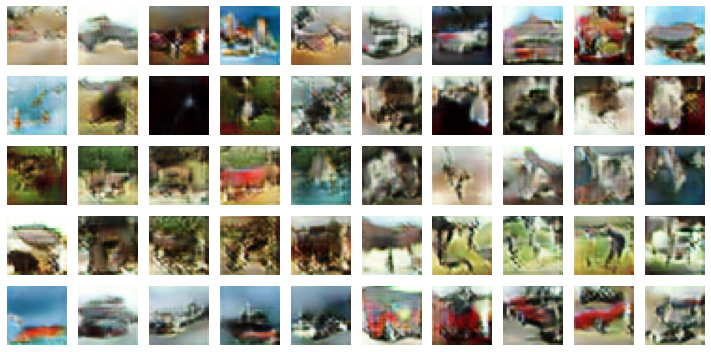

logs {'g_loss_step': tensor(-0.0207, device='cuda:0'), 'd_loss_step': tensor(2.0158, device='cuda:0'), 'kid': tensor(0.0535, device='cuda:0'), 'g_loss_epoch': tensor(0.0174, device='cuda:0'), 'd_loss_epoch': tensor(2.0019, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 12, 'kid': tensor(0.0410, device='cuda:0')}


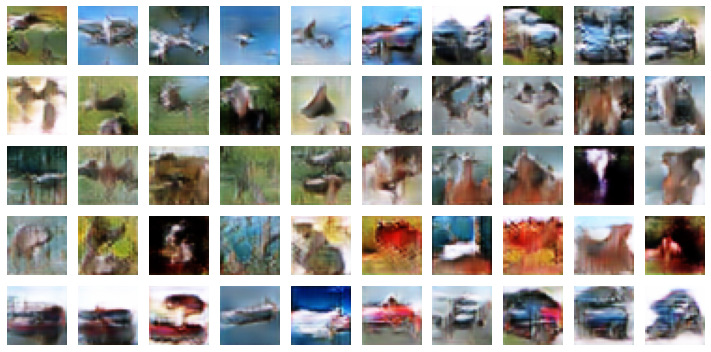

logs {'g_loss_step': tensor(-0.0392, device='cuda:0'), 'd_loss_step': tensor(2.0016, device='cuda:0'), 'kid': tensor(0.0410, device='cuda:0'), 'g_loss_epoch': tensor(-0.0210, device='cuda:0'), 'd_loss_epoch': tensor(2.0011, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 13, 'kid': tensor(0.0430, device='cuda:0')}


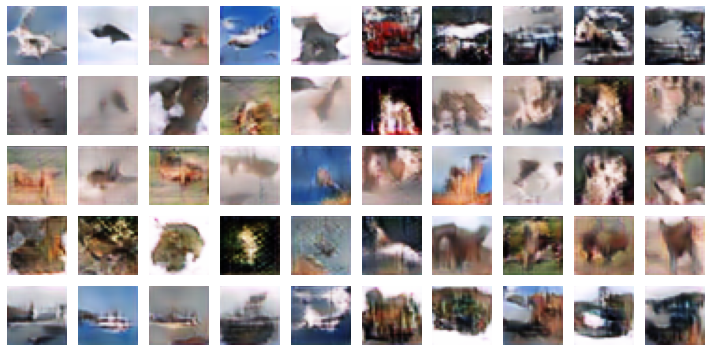

logs {'g_loss_step': tensor(-0.0197, device='cuda:0'), 'd_loss_step': tensor(2.0234, device='cuda:0'), 'kid': tensor(0.0430, device='cuda:0'), 'g_loss_epoch': tensor(-0.0086, device='cuda:0'), 'd_loss_epoch': tensor(2.0008, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 14, 'kid': tensor(0.0427, device='cuda:0')}


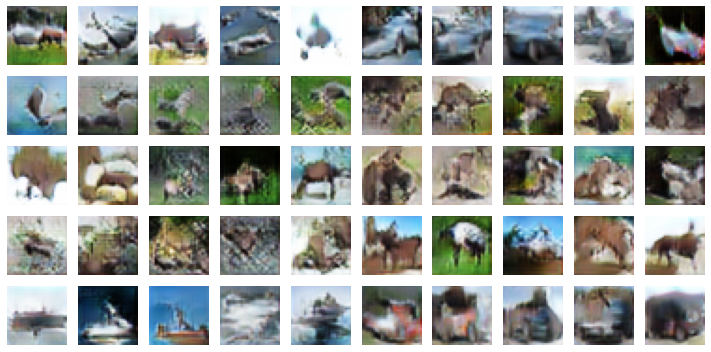

logs {'g_loss_step': tensor(-0.0408, device='cuda:0'), 'd_loss_step': tensor(1.9961, device='cuda:0'), 'kid': tensor(0.0427, device='cuda:0'), 'g_loss_epoch': tensor(-0.0125, device='cuda:0'), 'd_loss_epoch': tensor(2.0003, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 15, 'kid': tensor(0.0387, device='cuda:0')}


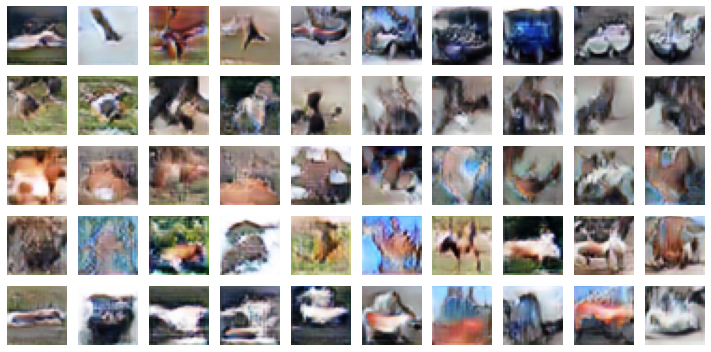

logs {'g_loss_step': tensor(0.0104, device='cuda:0'), 'd_loss_step': tensor(2.0092, device='cuda:0'), 'kid': tensor(0.0387, device='cuda:0'), 'g_loss_epoch': tensor(-0.0116, device='cuda:0'), 'd_loss_epoch': tensor(2.0011, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 16, 'kid': tensor(0.0344, device='cuda:0')}


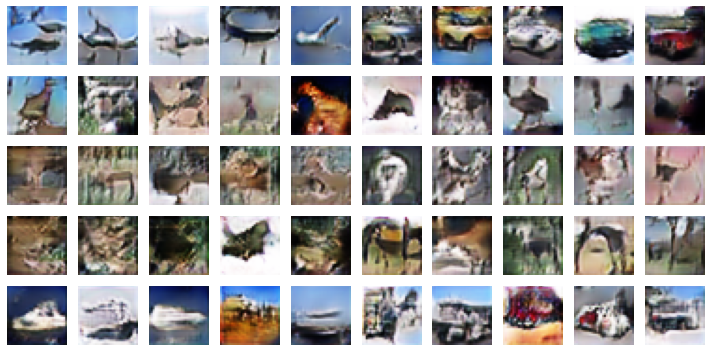

logs {'g_loss_step': tensor(0.0308, device='cuda:0'), 'd_loss_step': tensor(2.0150, device='cuda:0'), 'kid': tensor(0.0344, device='cuda:0'), 'g_loss_epoch': tensor(-0.0110, device='cuda:0'), 'd_loss_epoch': tensor(2.0006, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 17, 'kid': tensor(0.0395, device='cuda:0')}


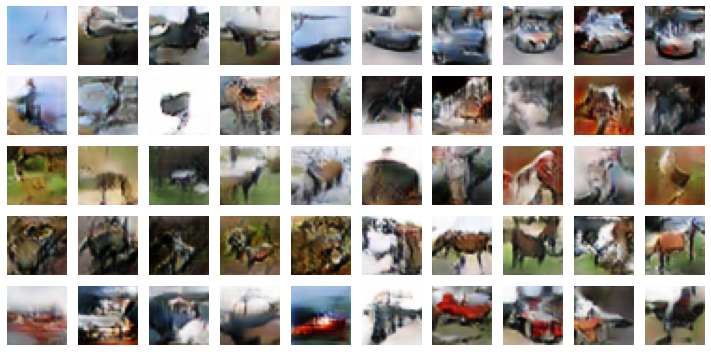

logs {'g_loss_step': tensor(-0.0177, device='cuda:0'), 'd_loss_step': tensor(2.0081, device='cuda:0'), 'kid': tensor(0.0395, device='cuda:0'), 'g_loss_epoch': tensor(-0.0344, device='cuda:0'), 'd_loss_epoch': tensor(2.0000, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 18, 'kid': tensor(0.0438, device='cuda:0')}


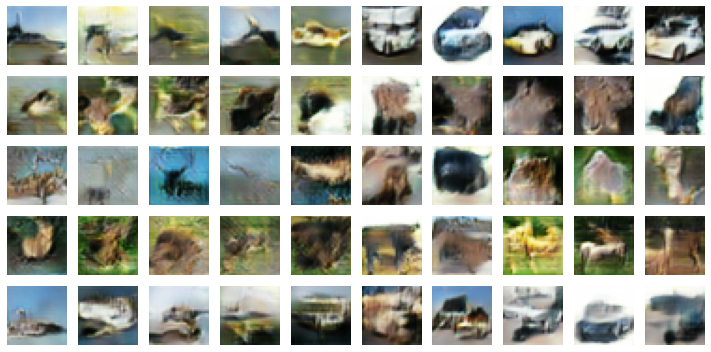

logs {'g_loss_step': tensor(0.1165, device='cuda:0'), 'd_loss_step': tensor(1.9991, device='cuda:0'), 'kid': tensor(0.0438, device='cuda:0'), 'g_loss_epoch': tensor(-0.0118, device='cuda:0'), 'd_loss_epoch': tensor(1.9998, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 19, 'kid': tensor(0.0340, device='cuda:0')}


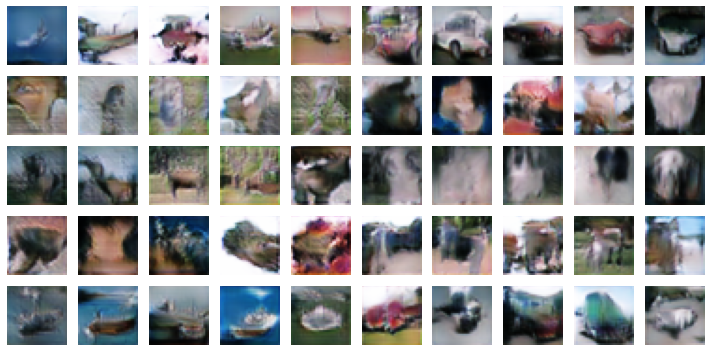

logs {'g_loss_step': tensor(-0.0205, device='cuda:0'), 'd_loss_step': tensor(2.0183, device='cuda:0'), 'kid': tensor(0.0340, device='cuda:0'), 'g_loss_epoch': tensor(0.0104, device='cuda:0'), 'd_loss_epoch': tensor(2.0003, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 20, 'kid': tensor(0.0284, device='cuda:0')}


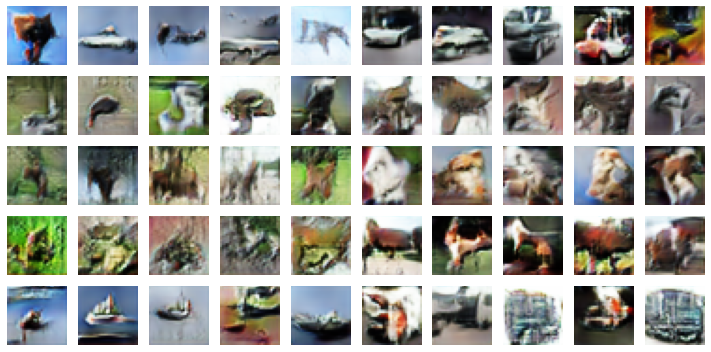

logs {'g_loss_step': tensor(-0.0866, device='cuda:0'), 'd_loss_step': tensor(2.0009, device='cuda:0'), 'kid': tensor(0.0284, device='cuda:0'), 'g_loss_epoch': tensor(0.0011, device='cuda:0'), 'd_loss_epoch': tensor(2.0005, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 21, 'kid': tensor(0.0391, device='cuda:0')}


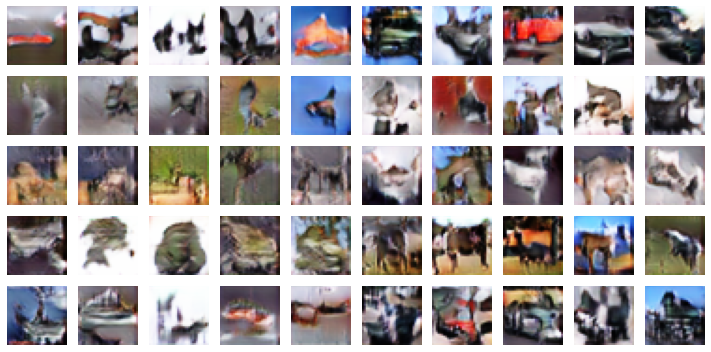

logs {'g_loss_step': tensor(0.0426, device='cuda:0'), 'd_loss_step': tensor(1.9935, device='cuda:0'), 'kid': tensor(0.0391, device='cuda:0'), 'g_loss_epoch': tensor(-0.0046, device='cuda:0'), 'd_loss_epoch': tensor(1.9997, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 22, 'kid': tensor(0.0416, device='cuda:0')}


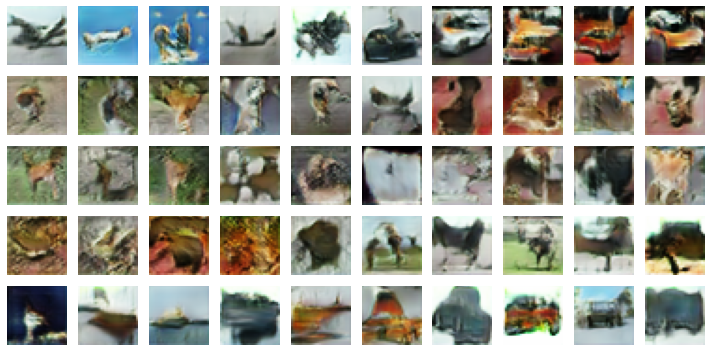

logs {'g_loss_step': tensor(-0.0287, device='cuda:0'), 'd_loss_step': tensor(2.0178, device='cuda:0'), 'kid': tensor(0.0416, device='cuda:0'), 'g_loss_epoch': tensor(0.0012, device='cuda:0'), 'd_loss_epoch': tensor(2.0001, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 23, 'kid': tensor(0.0318, device='cuda:0')}


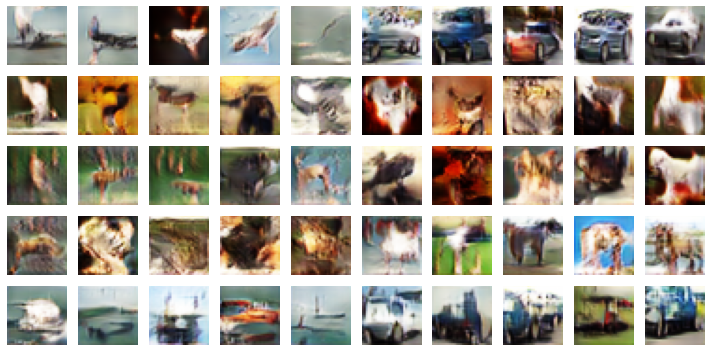

logs {'g_loss_step': tensor(-0.0946, device='cuda:0'), 'd_loss_step': tensor(2.0228, device='cuda:0'), 'kid': tensor(0.0318, device='cuda:0'), 'g_loss_epoch': tensor(-0.0093, device='cuda:0'), 'd_loss_epoch': tensor(1.9991, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 24, 'kid': tensor(0.0403, device='cuda:0')}


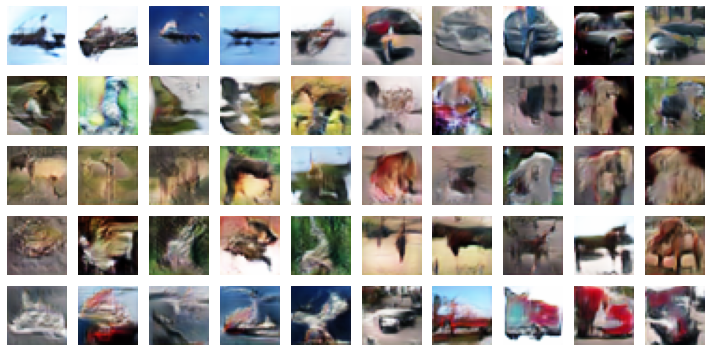

logs {'g_loss_step': tensor(-0.0143, device='cuda:0'), 'd_loss_step': tensor(2.0010, device='cuda:0'), 'kid': tensor(0.0403, device='cuda:0'), 'g_loss_epoch': tensor(-0.0256, device='cuda:0'), 'd_loss_epoch': tensor(1.9992, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 25, 'kid': tensor(0.0336, device='cuda:0')}


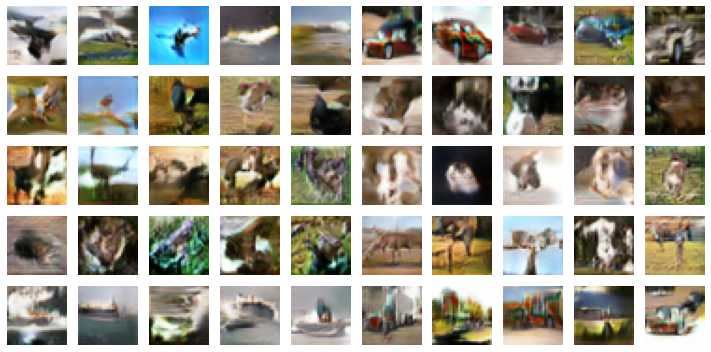

logs {'g_loss_step': tensor(-0.0515, device='cuda:0'), 'd_loss_step': tensor(2.0150, device='cuda:0'), 'kid': tensor(0.0336, device='cuda:0'), 'g_loss_epoch': tensor(-0.0347, device='cuda:0'), 'd_loss_epoch': tensor(1.9984, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 26, 'kid': tensor(0.0336, device='cuda:0')}


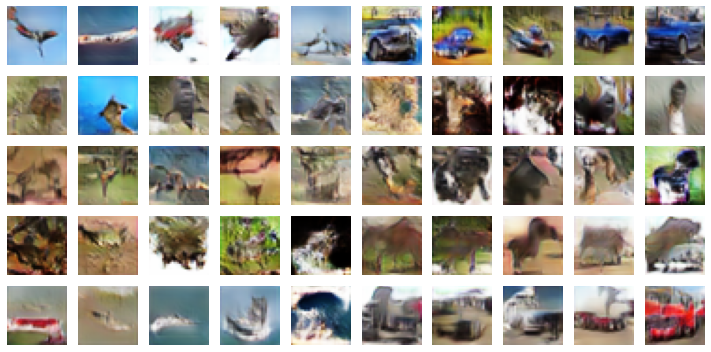

logs {'g_loss_step': tensor(-0.0536, device='cuda:0'), 'd_loss_step': tensor(2.0046, device='cuda:0'), 'kid': tensor(0.0336, device='cuda:0'), 'g_loss_epoch': tensor(-0.0479, device='cuda:0'), 'd_loss_epoch': tensor(1.9983, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 27, 'kid': tensor(0.0296, device='cuda:0')}


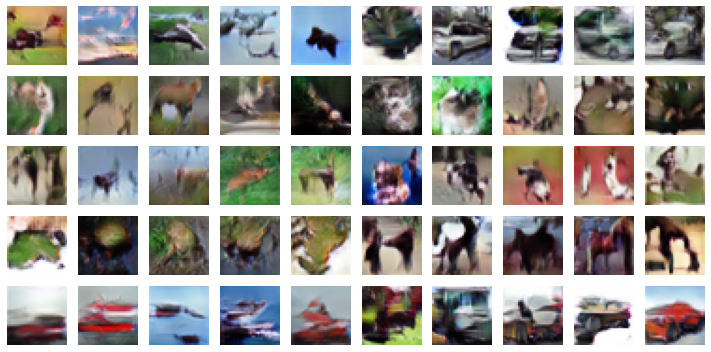

logs {'g_loss_step': tensor(-0.1170, device='cuda:0'), 'd_loss_step': tensor(1.9965, device='cuda:0'), 'kid': tensor(0.0296, device='cuda:0'), 'g_loss_epoch': tensor(-0.0444, device='cuda:0'), 'd_loss_epoch': tensor(1.9983, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 28, 'kid': tensor(0.0274, device='cuda:0')}


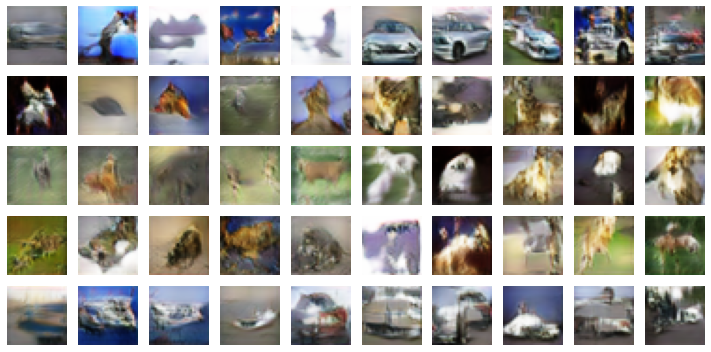

logs {'g_loss_step': tensor(-0.1780, device='cuda:0'), 'd_loss_step': tensor(2.0347, device='cuda:0'), 'kid': tensor(0.0274, device='cuda:0'), 'g_loss_epoch': tensor(-0.0664, device='cuda:0'), 'd_loss_epoch': tensor(1.9979, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 29, 'kid': tensor(0.0412, device='cuda:0')}


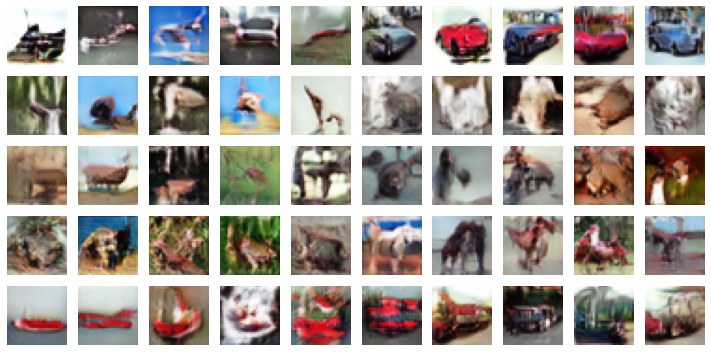

logs {'g_loss_step': tensor(-0.0226, device='cuda:0'), 'd_loss_step': tensor(2.0122, device='cuda:0'), 'kid': tensor(0.0412, device='cuda:0'), 'g_loss_epoch': tensor(-0.0675, device='cuda:0'), 'd_loss_epoch': tensor(1.9960, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 30, 'kid': tensor(0.0386, device='cuda:0')}


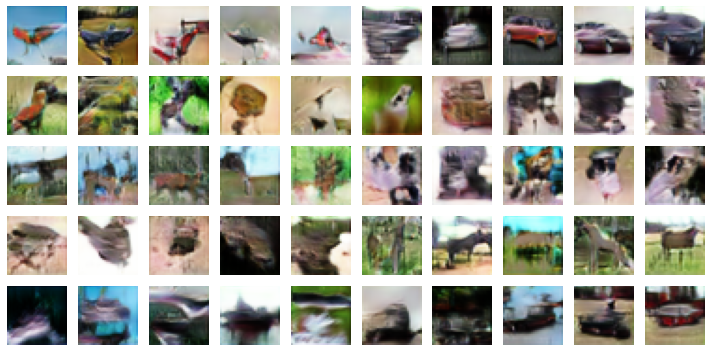

logs {'g_loss_step': tensor(-0.0664, device='cuda:0'), 'd_loss_step': tensor(2.0007, device='cuda:0'), 'kid': tensor(0.0386, device='cuda:0'), 'g_loss_epoch': tensor(-0.0689, device='cuda:0'), 'd_loss_epoch': tensor(1.9961, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 31, 'kid': tensor(0.0307, device='cuda:0')}


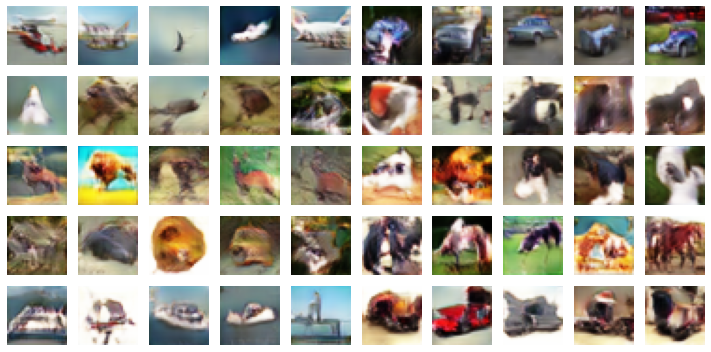

logs {'g_loss_step': tensor(-0.0681, device='cuda:0'), 'd_loss_step': tensor(2.0055, device='cuda:0'), 'kid': tensor(0.0307, device='cuda:0'), 'g_loss_epoch': tensor(-0.0566, device='cuda:0'), 'd_loss_epoch': tensor(1.9946, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 32, 'kid': tensor(0.0263, device='cuda:0')}


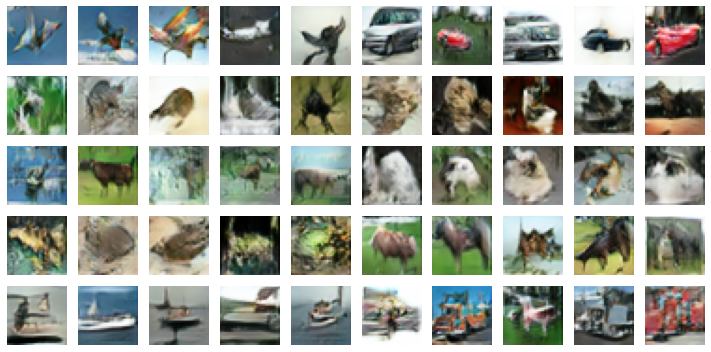

logs {'g_loss_step': tensor(-0.0452, device='cuda:0'), 'd_loss_step': tensor(2.0540, device='cuda:0'), 'kid': tensor(0.0263, device='cuda:0'), 'g_loss_epoch': tensor(-0.0247, device='cuda:0'), 'd_loss_epoch': tensor(1.9926, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 33, 'kid': tensor(0.0277, device='cuda:0')}


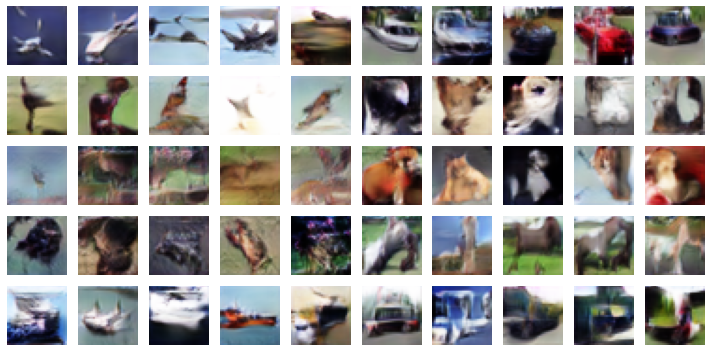

logs {'g_loss_step': tensor(-0.0290, device='cuda:0'), 'd_loss_step': tensor(1.9705, device='cuda:0'), 'kid': tensor(0.0277, device='cuda:0'), 'g_loss_epoch': tensor(0.0096, device='cuda:0'), 'd_loss_epoch': tensor(1.9915, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 34, 'kid': tensor(0.0281, device='cuda:0')}


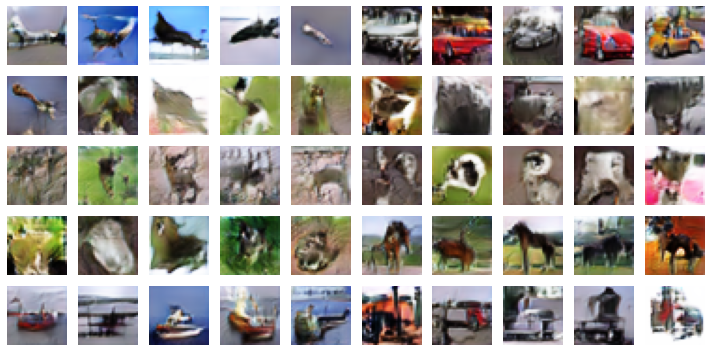

logs {'g_loss_step': tensor(0.0237, device='cuda:0'), 'd_loss_step': tensor(2.0227, device='cuda:0'), 'kid': tensor(0.0281, device='cuda:0'), 'g_loss_epoch': tensor(0.0706, device='cuda:0'), 'd_loss_epoch': tensor(1.9892, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 35, 'kid': tensor(0.0255, device='cuda:0')}


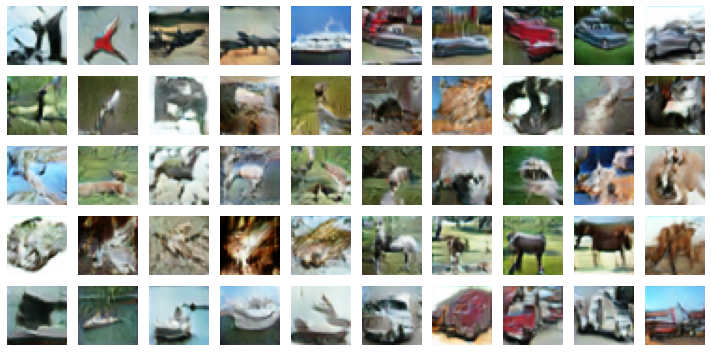

logs {'g_loss_step': tensor(0.1676, device='cuda:0'), 'd_loss_step': tensor(2.0334, device='cuda:0'), 'kid': tensor(0.0255, device='cuda:0'), 'g_loss_epoch': tensor(0.0911, device='cuda:0'), 'd_loss_epoch': tensor(1.9878, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 36, 'kid': tensor(0.0221, device='cuda:0')}


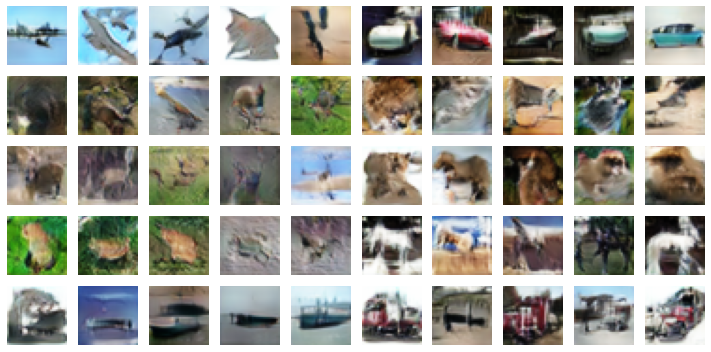

logs {'g_loss_step': tensor(0.1768, device='cuda:0'), 'd_loss_step': tensor(1.9616, device='cuda:0'), 'kid': tensor(0.0221, device='cuda:0'), 'g_loss_epoch': tensor(0.1578, device='cuda:0'), 'd_loss_epoch': tensor(1.9841, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 37, 'kid': tensor(0.0245, device='cuda:0')}


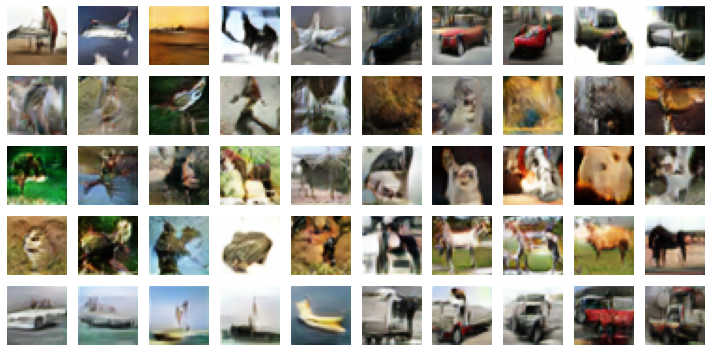

logs {'g_loss_step': tensor(0.1499, device='cuda:0'), 'd_loss_step': tensor(2.0165, device='cuda:0'), 'kid': tensor(0.0245, device='cuda:0'), 'g_loss_epoch': tensor(0.1860, device='cuda:0'), 'd_loss_epoch': tensor(1.9811, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 38, 'kid': tensor(0.0249, device='cuda:0')}


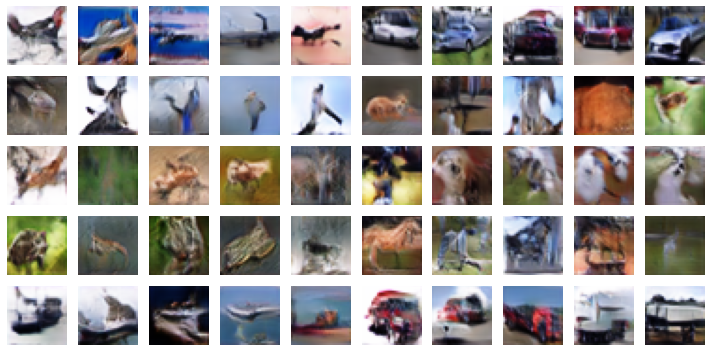

logs {'g_loss_step': tensor(0.1004, device='cuda:0'), 'd_loss_step': tensor(2.0528, device='cuda:0'), 'kid': tensor(0.0249, device='cuda:0'), 'g_loss_epoch': tensor(0.2290, device='cuda:0'), 'd_loss_epoch': tensor(1.9755, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 39, 'kid': tensor(0.0236, device='cuda:0')}


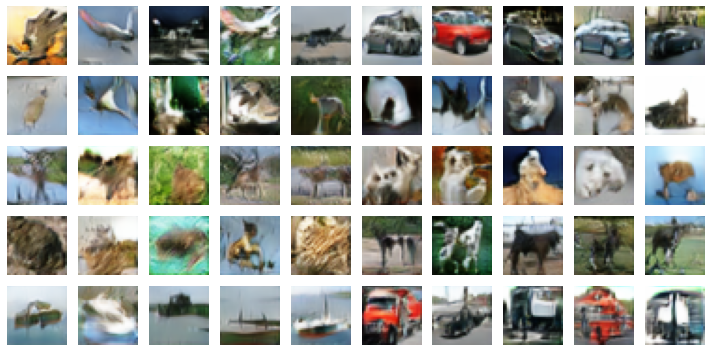

logs {'g_loss_step': tensor(-0.0338, device='cuda:0'), 'd_loss_step': tensor(2.0310, device='cuda:0'), 'kid': tensor(0.0236, device='cuda:0'), 'g_loss_epoch': tensor(0.2656, device='cuda:0'), 'd_loss_epoch': tensor(1.9718, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 40, 'kid': tensor(0.0257, device='cuda:0')}


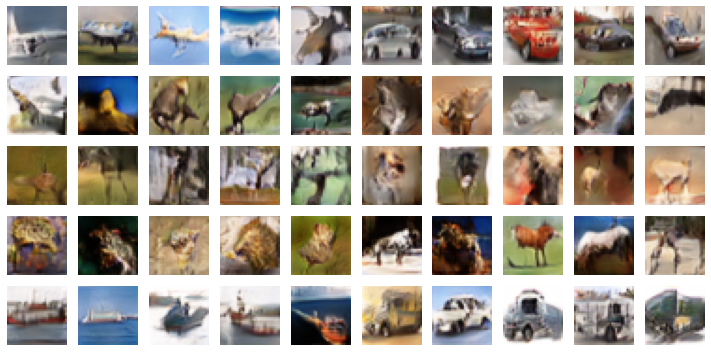

logs {'g_loss_step': tensor(0.3437, device='cuda:0'), 'd_loss_step': tensor(2.0466, device='cuda:0'), 'kid': tensor(0.0257, device='cuda:0'), 'g_loss_epoch': tensor(0.2945, device='cuda:0'), 'd_loss_epoch': tensor(1.9667, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 41, 'kid': tensor(0.0309, device='cuda:0')}


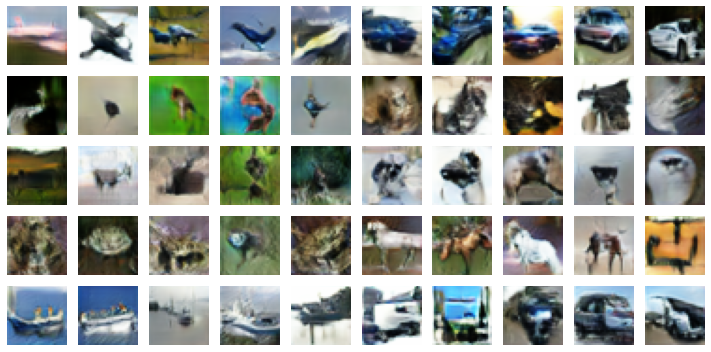

logs {'g_loss_step': tensor(0.3310, device='cuda:0'), 'd_loss_step': tensor(2.0050, device='cuda:0'), 'kid': tensor(0.0309, device='cuda:0'), 'g_loss_epoch': tensor(0.2954, device='cuda:0'), 'd_loss_epoch': tensor(1.9627, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 42, 'kid': tensor(0.0182, device='cuda:0')}


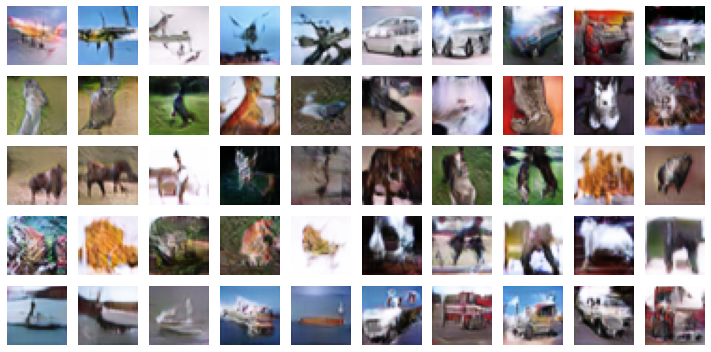

logs {'g_loss_step': tensor(0.3656, device='cuda:0'), 'd_loss_step': tensor(1.9204, device='cuda:0'), 'kid': tensor(0.0182, device='cuda:0'), 'g_loss_epoch': tensor(0.3288, device='cuda:0'), 'd_loss_epoch': tensor(1.9552, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 43, 'kid': tensor(0.0195, device='cuda:0')}


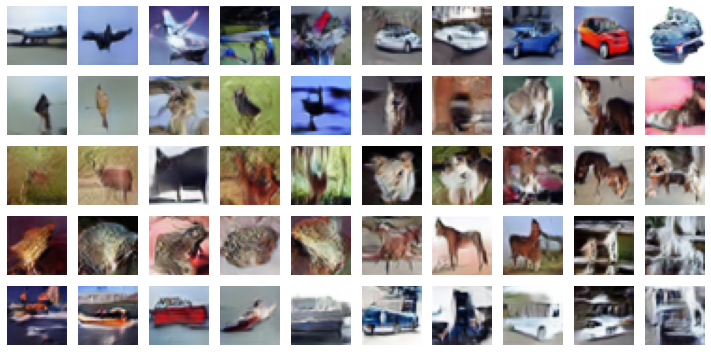

logs {'g_loss_step': tensor(0.5104, device='cuda:0'), 'd_loss_step': tensor(1.9538, device='cuda:0'), 'kid': tensor(0.0195, device='cuda:0'), 'g_loss_epoch': tensor(0.3521, device='cuda:0'), 'd_loss_epoch': tensor(1.9464, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 44, 'kid': tensor(0.0165, device='cuda:0')}


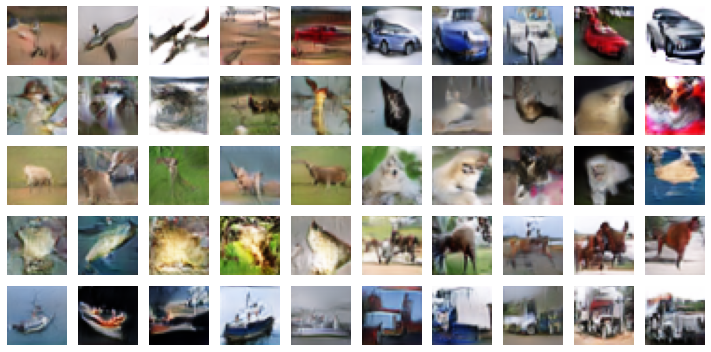

logs {'g_loss_step': tensor(0.5099, device='cuda:0'), 'd_loss_step': tensor(1.9333, device='cuda:0'), 'kid': tensor(0.0165, device='cuda:0'), 'g_loss_epoch': tensor(0.3415, device='cuda:0'), 'd_loss_epoch': tensor(1.9376, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 45, 'kid': tensor(0.0145, device='cuda:0')}


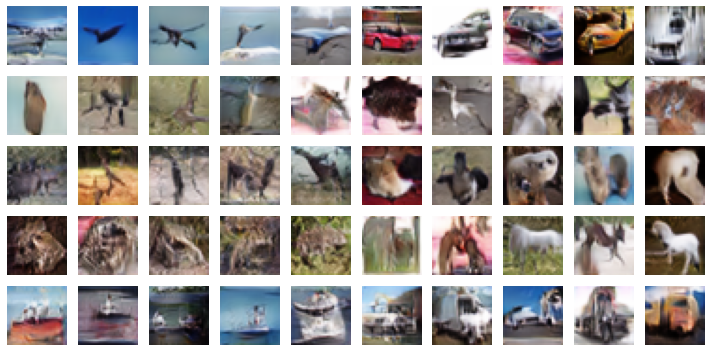

logs {'g_loss_step': tensor(0.4047, device='cuda:0'), 'd_loss_step': tensor(1.9463, device='cuda:0'), 'kid': tensor(0.0145, device='cuda:0'), 'g_loss_epoch': tensor(0.3776, device='cuda:0'), 'd_loss_epoch': tensor(1.9319, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 46, 'kid': tensor(0.0186, device='cuda:0')}


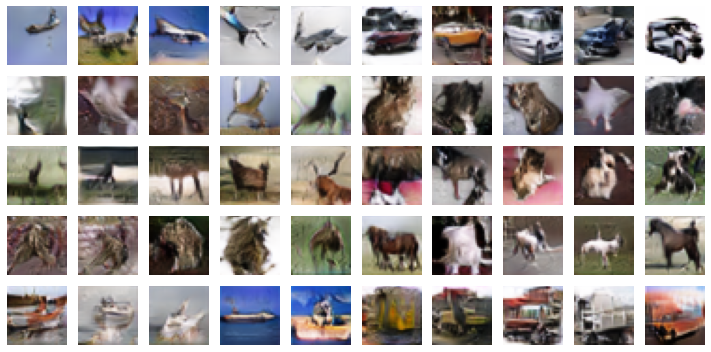

logs {'g_loss_step': tensor(0.2641, device='cuda:0'), 'd_loss_step': tensor(2.0206, device='cuda:0'), 'kid': tensor(0.0186, device='cuda:0'), 'g_loss_epoch': tensor(0.3786, device='cuda:0'), 'd_loss_epoch': tensor(1.9222, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 47, 'kid': tensor(0.0235, device='cuda:0')}


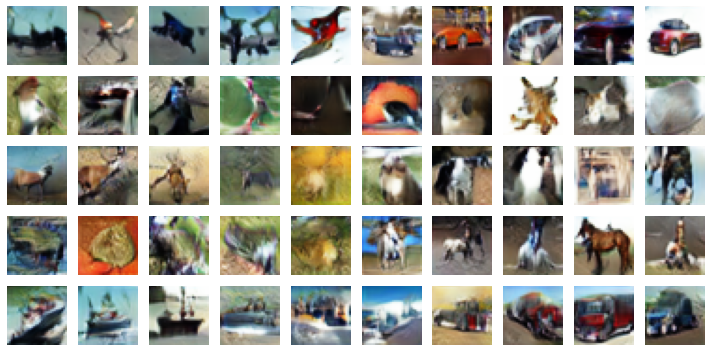

logs {'g_loss_step': tensor(0.1286, device='cuda:0'), 'd_loss_step': tensor(2.0368, device='cuda:0'), 'kid': tensor(0.0235, device='cuda:0'), 'g_loss_epoch': tensor(0.3790, device='cuda:0'), 'd_loss_epoch': tensor(1.9168, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 48, 'kid': tensor(0.0220, device='cuda:0')}


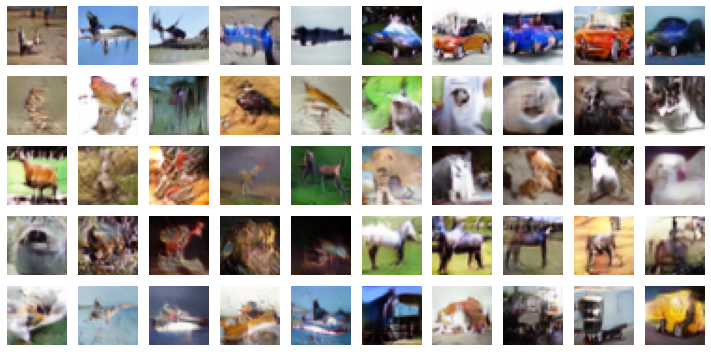

logs {'g_loss_step': tensor(0.5032, device='cuda:0'), 'd_loss_step': tensor(1.9395, device='cuda:0'), 'kid': tensor(0.0220, device='cuda:0'), 'g_loss_epoch': tensor(0.3823, device='cuda:0'), 'd_loss_epoch': tensor(1.9108, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 49, 'kid': tensor(0.0175, device='cuda:0')}


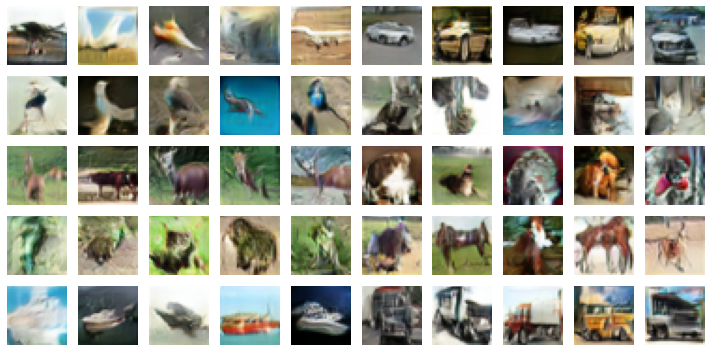

logs {'g_loss_step': tensor(0.2073, device='cuda:0'), 'd_loss_step': tensor(2.0568, device='cuda:0'), 'kid': tensor(0.0175, device='cuda:0'), 'g_loss_epoch': tensor(0.3838, device='cuda:0'), 'd_loss_epoch': tensor(1.9075, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 50, 'kid': tensor(0.0160, device='cuda:0')}


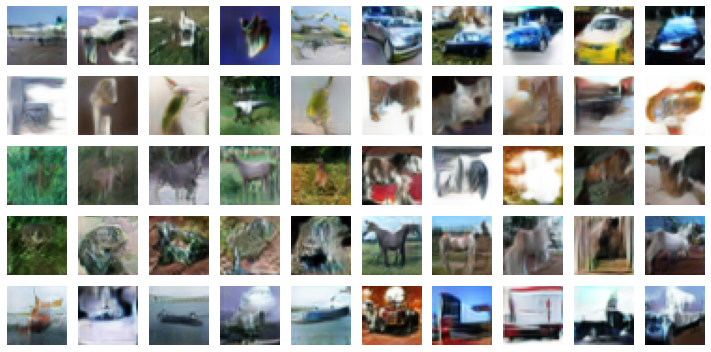

logs {'g_loss_step': tensor(0.5345, device='cuda:0'), 'd_loss_step': tensor(1.9130, device='cuda:0'), 'kid': tensor(0.0160, device='cuda:0'), 'g_loss_epoch': tensor(0.3993, device='cuda:0'), 'd_loss_epoch': tensor(1.8946, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 51, 'kid': tensor(0.0127, device='cuda:0')}


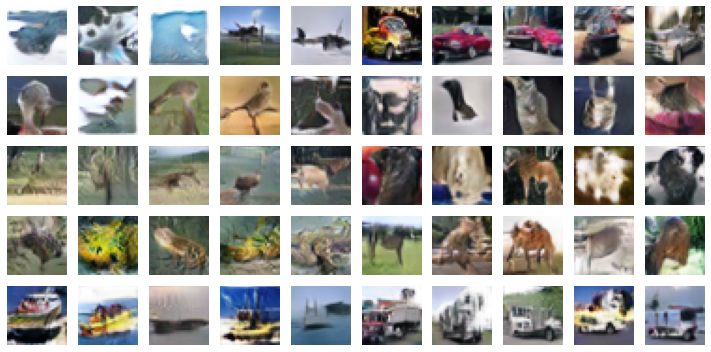

logs {'g_loss_step': tensor(0.1923, device='cuda:0'), 'd_loss_step': tensor(1.9934, device='cuda:0'), 'kid': tensor(0.0127, device='cuda:0'), 'g_loss_epoch': tensor(0.3954, device='cuda:0'), 'd_loss_epoch': tensor(1.8918, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 52, 'kid': tensor(0.0168, device='cuda:0')}


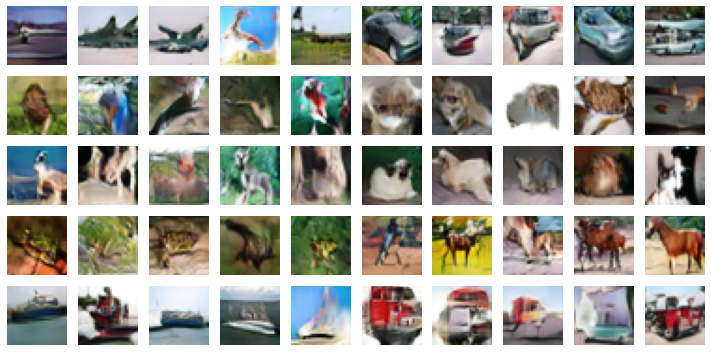

logs {'g_loss_step': tensor(0.3010, device='cuda:0'), 'd_loss_step': tensor(2.0282, device='cuda:0'), 'kid': tensor(0.0168, device='cuda:0'), 'g_loss_epoch': tensor(0.4185, device='cuda:0'), 'd_loss_epoch': tensor(1.8848, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 53, 'kid': tensor(0.0140, device='cuda:0')}


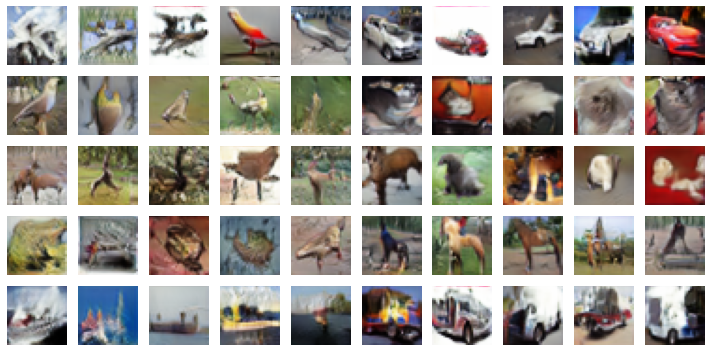

logs {'g_loss_step': tensor(0.4827, device='cuda:0'), 'd_loss_step': tensor(1.9396, device='cuda:0'), 'kid': tensor(0.0140, device='cuda:0'), 'g_loss_epoch': tensor(0.4328, device='cuda:0'), 'd_loss_epoch': tensor(1.8774, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 54, 'kid': tensor(0.0159, device='cuda:0')}


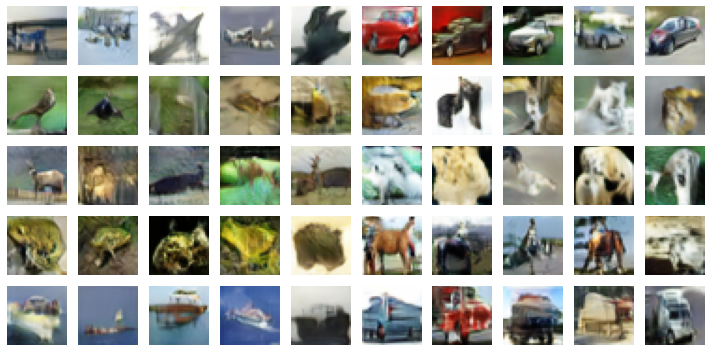

logs {'g_loss_step': tensor(0.5291, device='cuda:0'), 'd_loss_step': tensor(1.9644, device='cuda:0'), 'kid': tensor(0.0159, device='cuda:0'), 'g_loss_epoch': tensor(0.4373, device='cuda:0'), 'd_loss_epoch': tensor(1.8726, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 55, 'kid': tensor(0.0185, device='cuda:0')}


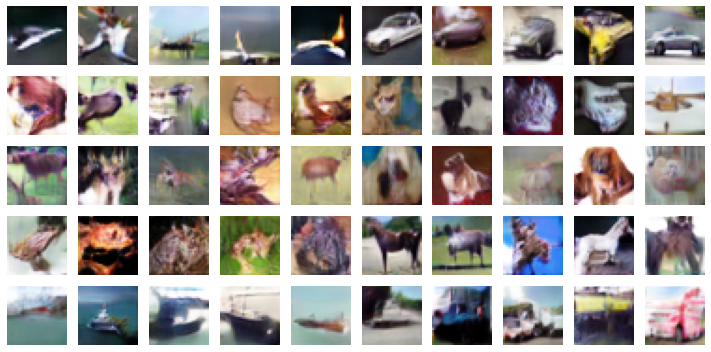

logs {'g_loss_step': tensor(0.5266, device='cuda:0'), 'd_loss_step': tensor(1.9322, device='cuda:0'), 'kid': tensor(0.0185, device='cuda:0'), 'g_loss_epoch': tensor(0.4226, device='cuda:0'), 'd_loss_epoch': tensor(1.8756, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 56, 'kid': tensor(0.0179, device='cuda:0')}


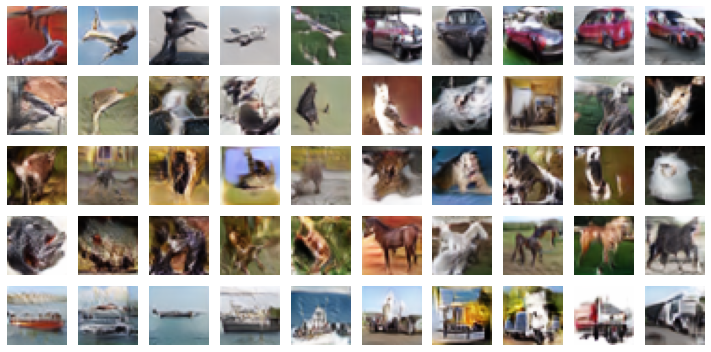

logs {'g_loss_step': tensor(0.4910, device='cuda:0'), 'd_loss_step': tensor(1.9628, device='cuda:0'), 'kid': tensor(0.0179, device='cuda:0'), 'g_loss_epoch': tensor(0.4501, device='cuda:0'), 'd_loss_epoch': tensor(1.8656, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 57, 'kid': tensor(0.0167, device='cuda:0')}


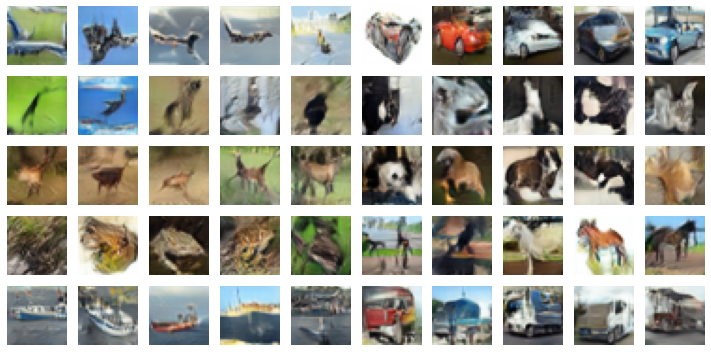

logs {'g_loss_step': tensor(0.3508, device='cuda:0'), 'd_loss_step': tensor(1.8899, device='cuda:0'), 'kid': tensor(0.0167, device='cuda:0'), 'g_loss_epoch': tensor(0.4500, device='cuda:0'), 'd_loss_epoch': tensor(1.8562, device='cuda:0')}


In [ ]:


import wandb
if __name__ == '__main__':
    wandb.login(key = '')
    wandb.init(project = 'projection discriminator cbn specnorm')

    gan = GAN(discriminator = Resnet_Discriminator() , generator = Resnet_Generator() ,dataloader = train_dataloader  , val_data= test_dataloader,
                          d_loss = hinge_loss , g_loss = generator_loss)
    tracker = MetricTracker()
    trainer = Trainer(gpus=1 , max_epochs  = 100 ,callbacks = [TQDMProgressBar(1) ,tracker]   , enable_model_summary=False ,num_sanity_val_steps=0,limit_train_batches=1.0, limit_val_batches=1.0)

    trainer.fit( gan)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: yh1234. Use `wandb login --relogin` to force relogin


/usr/local/lib/python3.8/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Metric `Kernel Inception Distance` will save all extracted features in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)
Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth


  0%|          | 0.00/91.2M [00:00<?, ?B/s]

/usr/local/lib/python3.8/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:467: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  rank_zero_deprecation(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.8/dist-packages/pytorch_lightning/trainer/connectors/logger_connector/logger_connector.py:67: UserWarning: Starting from v1.9.0, `tensorboardX` has been removed as a dependency of the `pytorch_lightning` package, due to potential conflicts with other packages in the ML ecosystem. For this reason, `logger=True` will use `CSVLogger` as the default logger, 

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

{'epoch': 0, 'kid': tensor(0.0115, device='cuda:0')}


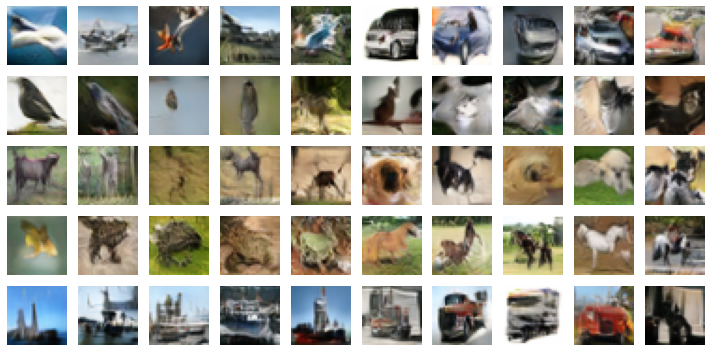

logs {'g_loss_step': tensor(0.8697, device='cuda:0'), 'd_loss_step': tensor(1.8830, device='cuda:0'), 'kid': tensor(0.0115, device='cuda:0'), 'g_loss_epoch': tensor(0.5922, device='cuda:0'), 'd_loss_epoch': tensor(1.7284, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 1, 'kid': tensor(0.0150, device='cuda:0')}


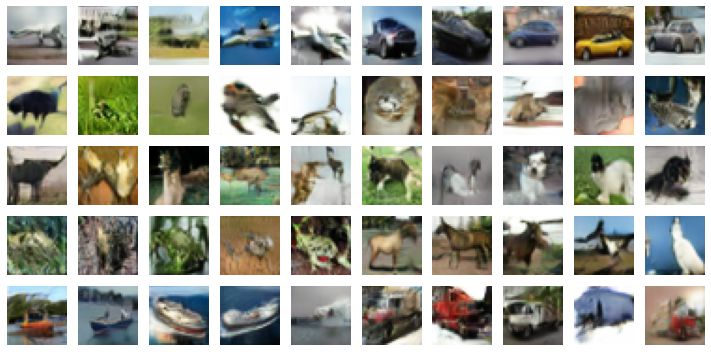

logs {'g_loss_step': tensor(0.4849, device='cuda:0'), 'd_loss_step': tensor(1.7652, device='cuda:0'), 'kid': tensor(0.0150, device='cuda:0'), 'g_loss_epoch': tensor(0.5941, device='cuda:0'), 'd_loss_epoch': tensor(1.7286, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 2, 'kid': tensor(0.0107, device='cuda:0')}


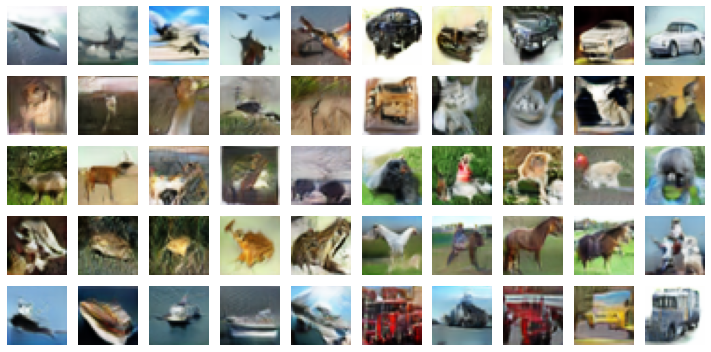

logs {'g_loss_step': tensor(0.8651, device='cuda:0'), 'd_loss_step': tensor(1.9124, device='cuda:0'), 'kid': tensor(0.0107, device='cuda:0'), 'g_loss_epoch': tensor(0.5959, device='cuda:0'), 'd_loss_epoch': tensor(1.7253, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 3, 'kid': tensor(0.0105, device='cuda:0')}


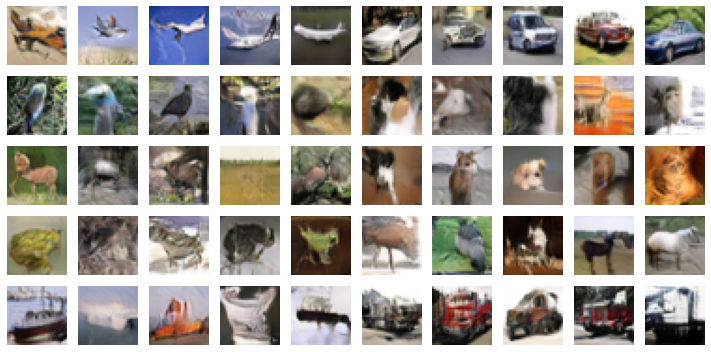

logs {'g_loss_step': tensor(0.6440, device='cuda:0'), 'd_loss_step': tensor(1.7302, device='cuda:0'), 'kid': tensor(0.0105, device='cuda:0'), 'g_loss_epoch': tensor(0.5933, device='cuda:0'), 'd_loss_epoch': tensor(1.7252, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 4, 'kid': tensor(0.0109, device='cuda:0')}


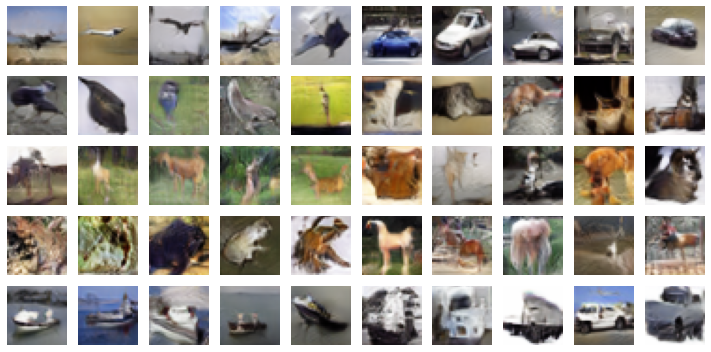

logs {'g_loss_step': tensor(1.1147, device='cuda:0'), 'd_loss_step': tensor(1.8385, device='cuda:0'), 'kid': tensor(0.0109, device='cuda:0'), 'g_loss_epoch': tensor(0.5967, device='cuda:0'), 'd_loss_epoch': tensor(1.7223, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 5, 'kid': tensor(0.0122, device='cuda:0')}


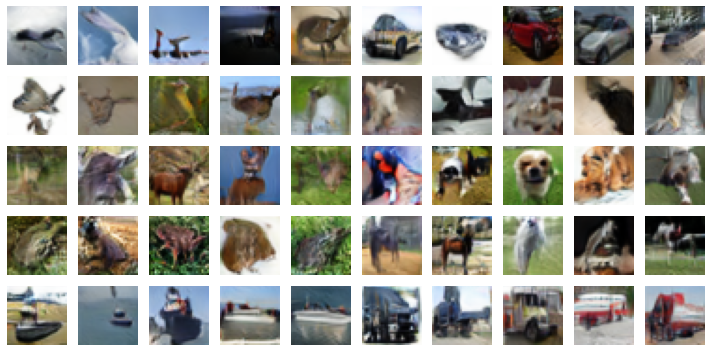

logs {'g_loss_step': tensor(0.2273, device='cuda:0'), 'd_loss_step': tensor(1.8809, device='cuda:0'), 'kid': tensor(0.0122, device='cuda:0'), 'g_loss_epoch': tensor(0.6001, device='cuda:0'), 'd_loss_epoch': tensor(1.7195, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 6, 'kid': tensor(0.0096, device='cuda:0')}


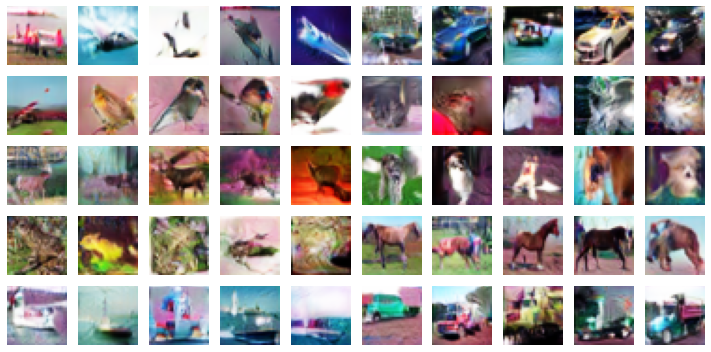

logs {'g_loss_step': tensor(0.7477, device='cuda:0'), 'd_loss_step': tensor(1.8721, device='cuda:0'), 'kid': tensor(0.0096, device='cuda:0'), 'g_loss_epoch': tensor(0.5968, device='cuda:0'), 'd_loss_epoch': tensor(1.7131, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 7, 'kid': tensor(0.0098, device='cuda:0')}


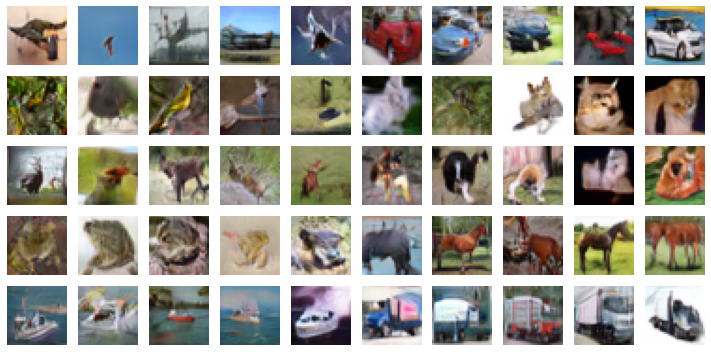

logs {'g_loss_step': tensor(1.1223, device='cuda:0'), 'd_loss_step': tensor(1.7482, device='cuda:0'), 'kid': tensor(0.0098, device='cuda:0'), 'g_loss_epoch': tensor(0.6040, device='cuda:0'), 'd_loss_epoch': tensor(1.7142, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 8, 'kid': tensor(0.0109, device='cuda:0')}


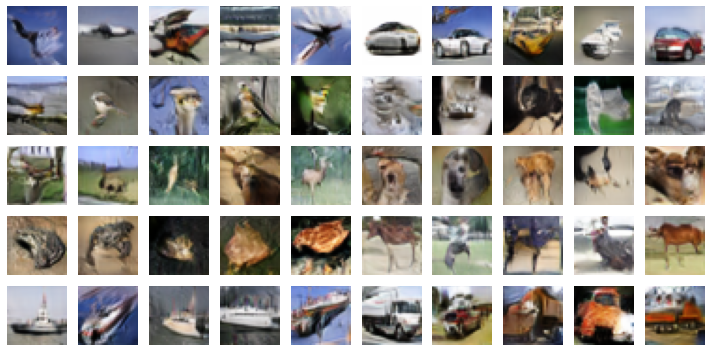

logs {'g_loss_step': tensor(0.3468, device='cuda:0'), 'd_loss_step': tensor(1.7198, device='cuda:0'), 'kid': tensor(0.0109, device='cuda:0'), 'g_loss_epoch': tensor(0.6130, device='cuda:0'), 'd_loss_epoch': tensor(1.7069, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 9, 'kid': tensor(0.0109, device='cuda:0')}


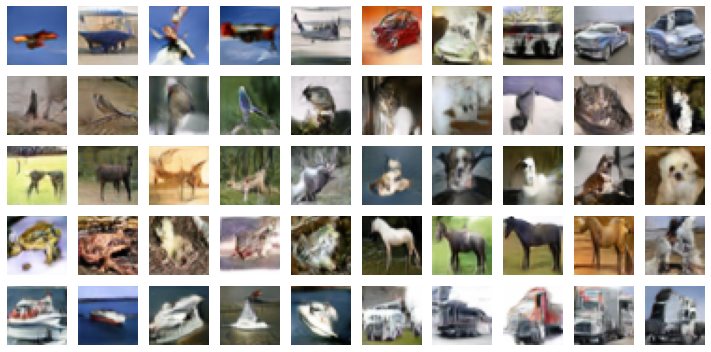

logs {'g_loss_step': tensor(0.7525, device='cuda:0'), 'd_loss_step': tensor(1.9599, device='cuda:0'), 'kid': tensor(0.0109, device='cuda:0'), 'g_loss_epoch': tensor(0.6173, device='cuda:0'), 'd_loss_epoch': tensor(1.7060, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 10, 'kid': tensor(0.0109, device='cuda:0')}


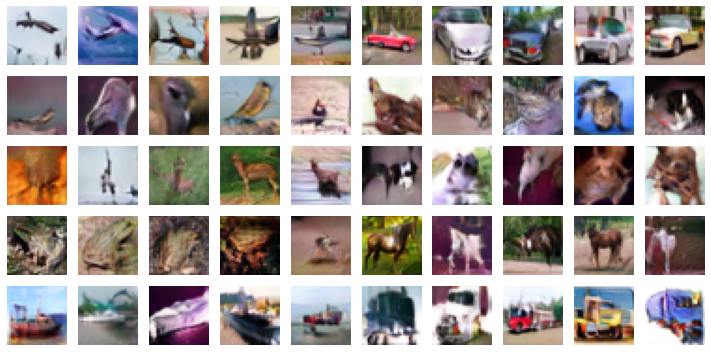

logs {'g_loss_step': tensor(0.9044, device='cuda:0'), 'd_loss_step': tensor(1.8545, device='cuda:0'), 'kid': tensor(0.0109, device='cuda:0'), 'g_loss_epoch': tensor(0.6218, device='cuda:0'), 'd_loss_epoch': tensor(1.6990, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 11, 'kid': tensor(0.0153, device='cuda:0')}


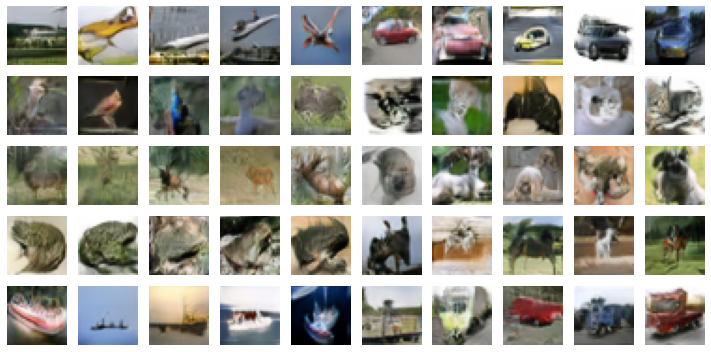

logs {'g_loss_step': tensor(0.5212, device='cuda:0'), 'd_loss_step': tensor(1.7437, device='cuda:0'), 'kid': tensor(0.0153, device='cuda:0'), 'g_loss_epoch': tensor(0.6208, device='cuda:0'), 'd_loss_epoch': tensor(1.7021, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 12, 'kid': tensor(0.0105, device='cuda:0')}


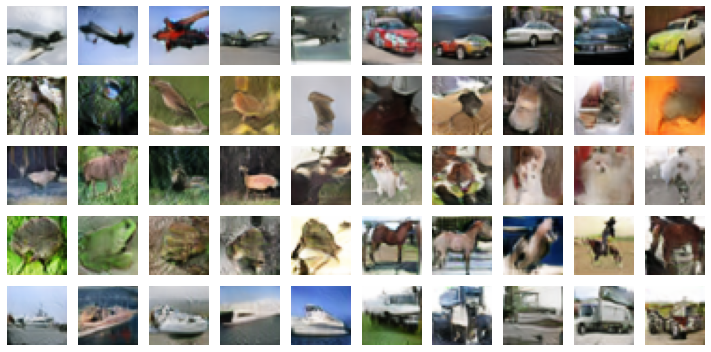

logs {'g_loss_step': tensor(0.4720, device='cuda:0'), 'd_loss_step': tensor(1.7932, device='cuda:0'), 'kid': tensor(0.0105, device='cuda:0'), 'g_loss_epoch': tensor(0.6200, device='cuda:0'), 'd_loss_epoch': tensor(1.6932, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 13, 'kid': tensor(0.0132, device='cuda:0')}


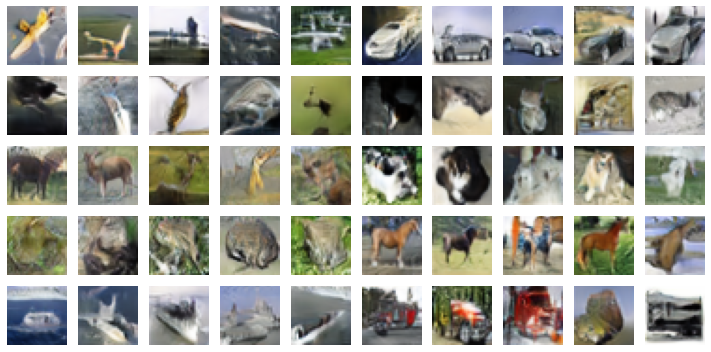

logs {'g_loss_step': tensor(1.0208, device='cuda:0'), 'd_loss_step': tensor(1.6351, device='cuda:0'), 'kid': tensor(0.0132, device='cuda:0'), 'g_loss_epoch': tensor(0.6118, device='cuda:0'), 'd_loss_epoch': tensor(1.6917, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 14, 'kid': tensor(0.0147, device='cuda:0')}


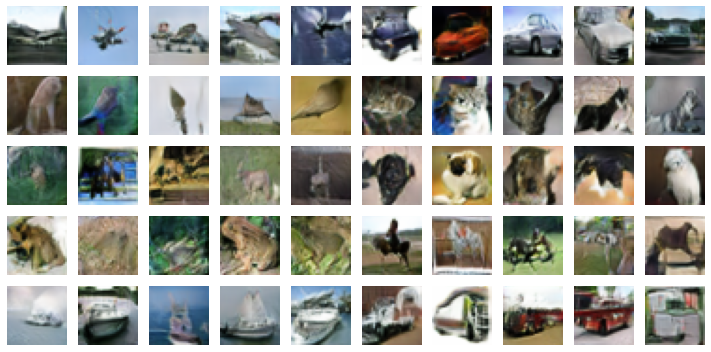

logs {'g_loss_step': tensor(0.4630, device='cuda:0'), 'd_loss_step': tensor(1.8129, device='cuda:0'), 'kid': tensor(0.0147, device='cuda:0'), 'g_loss_epoch': tensor(0.6393, device='cuda:0'), 'd_loss_epoch': tensor(1.6850, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 15, 'kid': tensor(0.0112, device='cuda:0')}


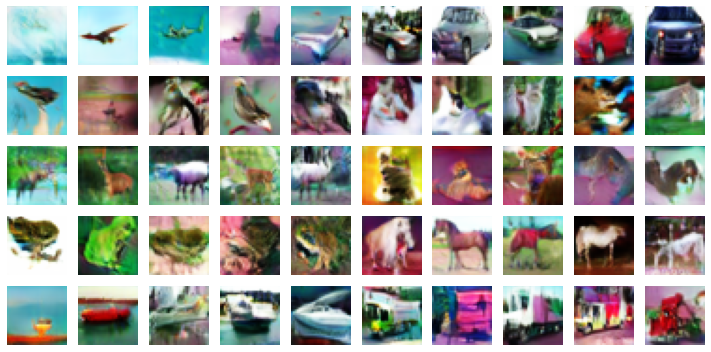

logs {'g_loss_step': tensor(0.4455, device='cuda:0'), 'd_loss_step': tensor(1.9561, device='cuda:0'), 'kid': tensor(0.0112, device='cuda:0'), 'g_loss_epoch': tensor(0.6298, device='cuda:0'), 'd_loss_epoch': tensor(1.6868, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 16, 'kid': tensor(0.0100, device='cuda:0')}


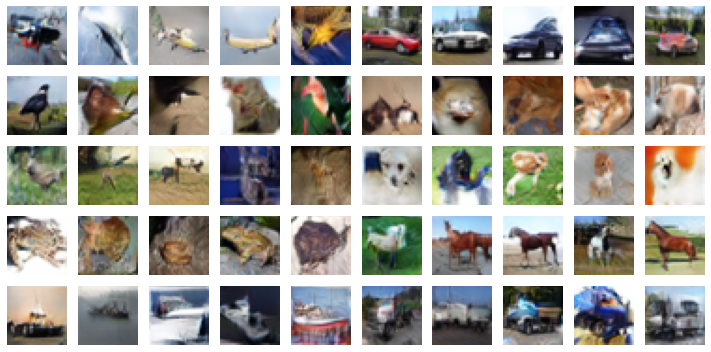

logs {'g_loss_step': tensor(-0.0927, device='cuda:0'), 'd_loss_step': tensor(2.2695, device='cuda:0'), 'kid': tensor(0.0100, device='cuda:0'), 'g_loss_epoch': tensor(0.6436, device='cuda:0'), 'd_loss_epoch': tensor(1.6774, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 17, 'kid': tensor(0.0090, device='cuda:0')}


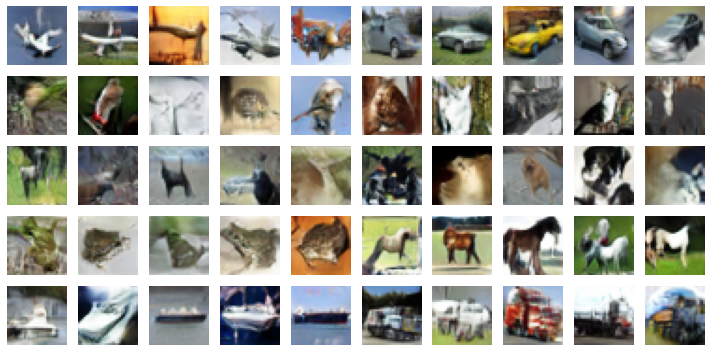

logs {'g_loss_step': tensor(1.0218, device='cuda:0'), 'd_loss_step': tensor(1.9936, device='cuda:0'), 'kid': tensor(0.0090, device='cuda:0'), 'g_loss_epoch': tensor(0.6442, device='cuda:0'), 'd_loss_epoch': tensor(1.6791, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 18, 'kid': tensor(0.0102, device='cuda:0')}


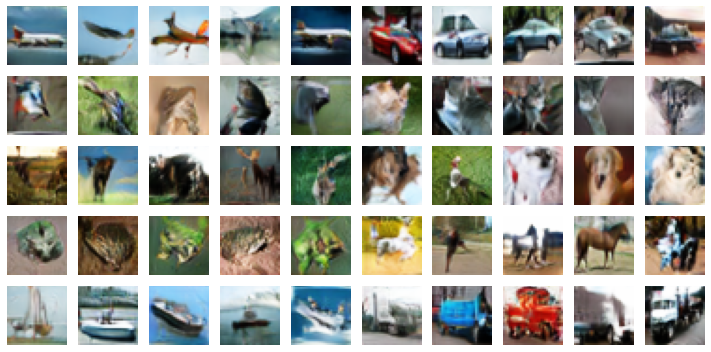

logs {'g_loss_step': tensor(0.9967, device='cuda:0'), 'd_loss_step': tensor(1.5789, device='cuda:0'), 'kid': tensor(0.0102, device='cuda:0'), 'g_loss_epoch': tensor(0.6435, device='cuda:0'), 'd_loss_epoch': tensor(1.6709, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 19, 'kid': tensor(0.0112, device='cuda:0')}


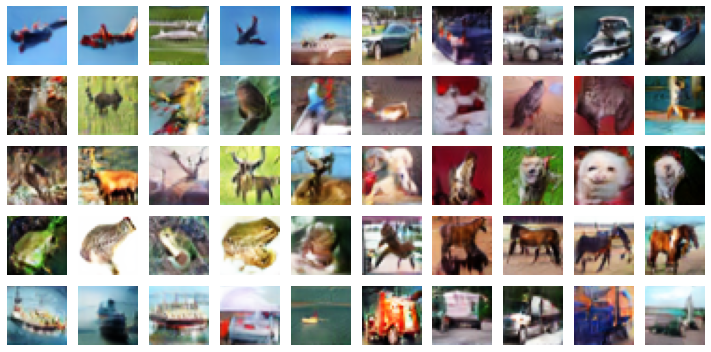

logs {'g_loss_step': tensor(0.9816, device='cuda:0'), 'd_loss_step': tensor(1.8554, device='cuda:0'), 'kid': tensor(0.0112, device='cuda:0'), 'g_loss_epoch': tensor(0.6461, device='cuda:0'), 'd_loss_epoch': tensor(1.6729, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 20, 'kid': tensor(0.0087, device='cuda:0')}


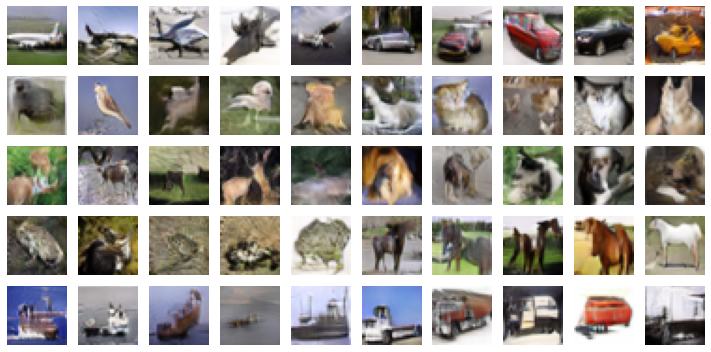

logs {'g_loss_step': tensor(0.5812, device='cuda:0'), 'd_loss_step': tensor(1.8843, device='cuda:0'), 'kid': tensor(0.0087, device='cuda:0'), 'g_loss_epoch': tensor(0.6445, device='cuda:0'), 'd_loss_epoch': tensor(1.6719, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 21, 'kid': tensor(0.0099, device='cuda:0')}


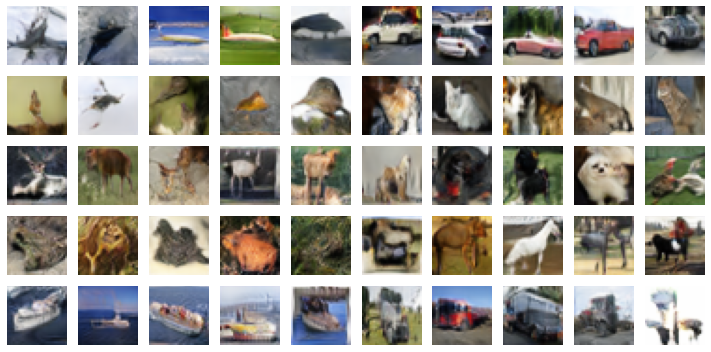

logs {'g_loss_step': tensor(0.8157, device='cuda:0'), 'd_loss_step': tensor(1.8244, device='cuda:0'), 'kid': tensor(0.0099, device='cuda:0'), 'g_loss_epoch': tensor(0.6513, device='cuda:0'), 'd_loss_epoch': tensor(1.6628, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 22, 'kid': tensor(0.0098, device='cuda:0')}


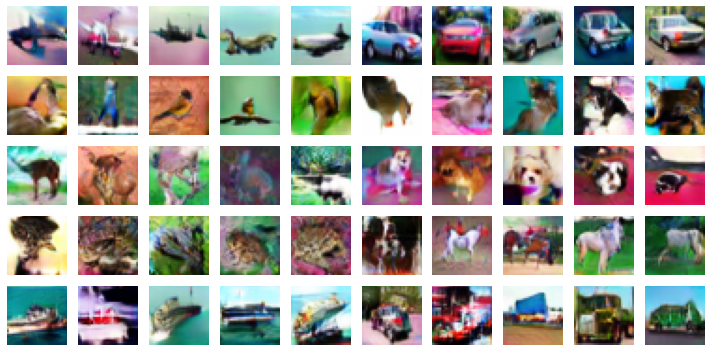

logs {'g_loss_step': tensor(0.6754, device='cuda:0'), 'd_loss_step': tensor(1.7554, device='cuda:0'), 'kid': tensor(0.0098, device='cuda:0'), 'g_loss_epoch': tensor(0.6553, device='cuda:0'), 'd_loss_epoch': tensor(1.6650, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 23, 'kid': tensor(0.0107, device='cuda:0')}


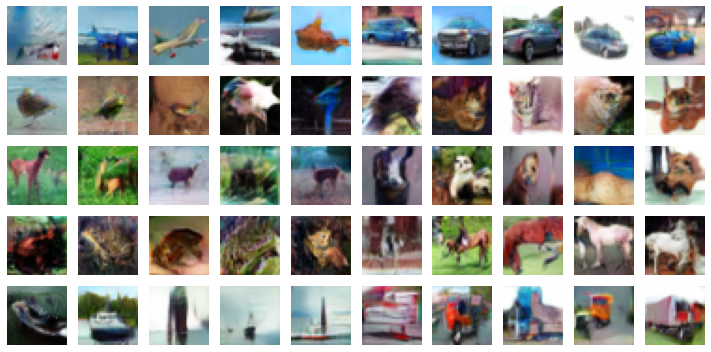

logs {'g_loss_step': tensor(0.4555, device='cuda:0'), 'd_loss_step': tensor(1.8727, device='cuda:0'), 'kid': tensor(0.0107, device='cuda:0'), 'g_loss_epoch': tensor(0.6571, device='cuda:0'), 'd_loss_epoch': tensor(1.6628, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 24, 'kid': tensor(0.0103, device='cuda:0')}


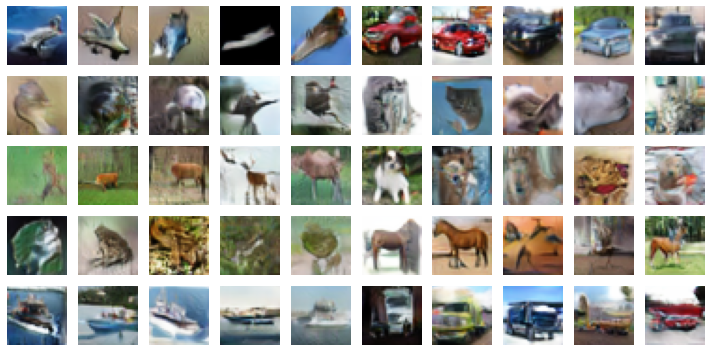

logs {'g_loss_step': tensor(0.5906, device='cuda:0'), 'd_loss_step': tensor(1.7402, device='cuda:0'), 'kid': tensor(0.0103, device='cuda:0'), 'g_loss_epoch': tensor(0.6537, device='cuda:0'), 'd_loss_epoch': tensor(1.6555, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 25, 'kid': tensor(0.0094, device='cuda:0')}


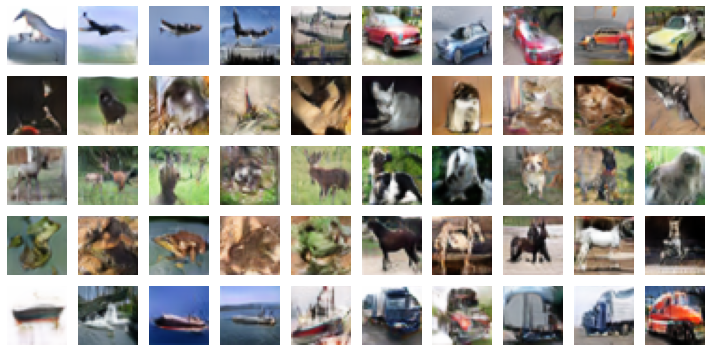

logs {'g_loss_step': tensor(0.4212, device='cuda:0'), 'd_loss_step': tensor(1.7431, device='cuda:0'), 'kid': tensor(0.0094, device='cuda:0'), 'g_loss_epoch': tensor(0.6631, device='cuda:0'), 'd_loss_epoch': tensor(1.6500, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 26, 'kid': tensor(0.0136, device='cuda:0')}


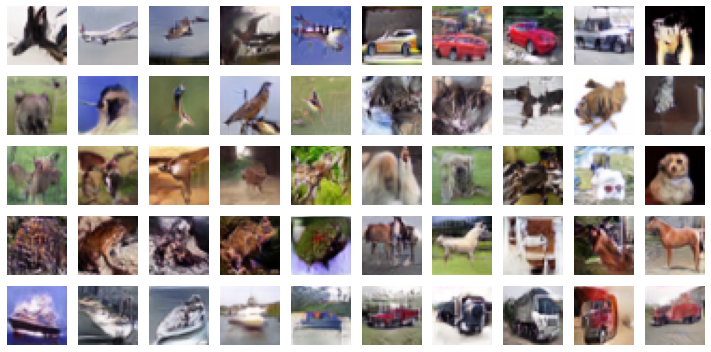

logs {'g_loss_step': tensor(0.9200, device='cuda:0'), 'd_loss_step': tensor(1.7083, device='cuda:0'), 'kid': tensor(0.0136, device='cuda:0'), 'g_loss_epoch': tensor(0.6603, device='cuda:0'), 'd_loss_epoch': tensor(1.6554, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 27, 'kid': tensor(0.0100, device='cuda:0')}


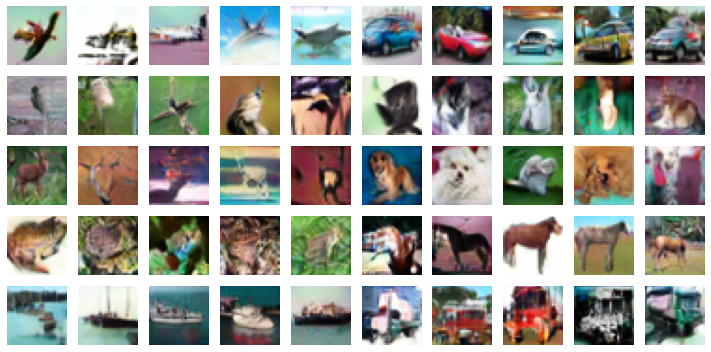

logs {'g_loss_step': tensor(1.2634, device='cuda:0'), 'd_loss_step': tensor(1.8476, device='cuda:0'), 'kid': tensor(0.0100, device='cuda:0'), 'g_loss_epoch': tensor(0.6655, device='cuda:0'), 'd_loss_epoch': tensor(1.6480, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 28, 'kid': tensor(0.0105, device='cuda:0')}


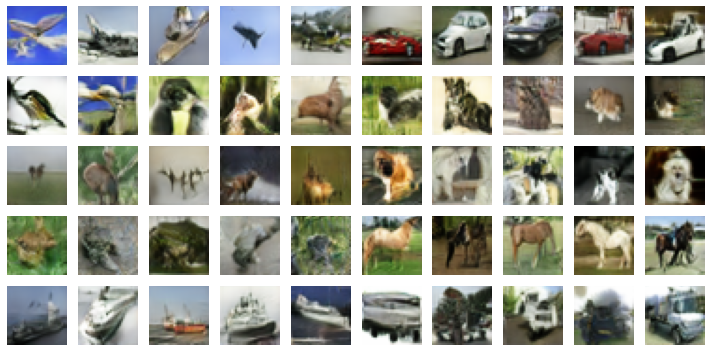

logs {'g_loss_step': tensor(0.6594, device='cuda:0'), 'd_loss_step': tensor(1.7745, device='cuda:0'), 'kid': tensor(0.0105, device='cuda:0'), 'g_loss_epoch': tensor(0.6708, device='cuda:0'), 'd_loss_epoch': tensor(1.6449, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 29, 'kid': tensor(0.0110, device='cuda:0')}


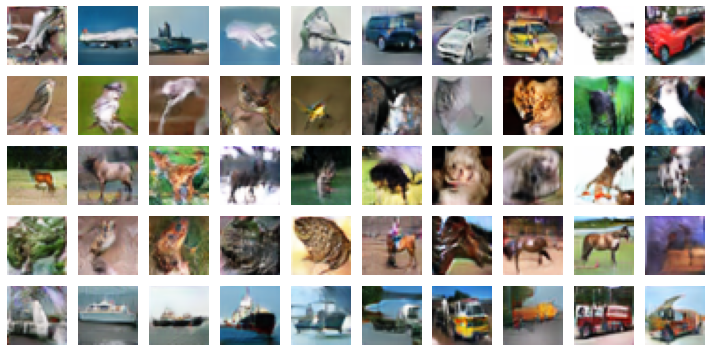

logs {'g_loss_step': tensor(0.9190, device='cuda:0'), 'd_loss_step': tensor(1.7542, device='cuda:0'), 'kid': tensor(0.0110, device='cuda:0'), 'g_loss_epoch': tensor(0.6770, device='cuda:0'), 'd_loss_epoch': tensor(1.6413, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 30, 'kid': tensor(0.0101, device='cuda:0')}


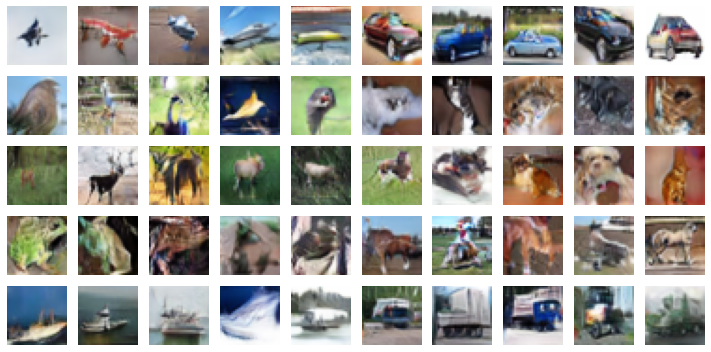

logs {'g_loss_step': tensor(0.4176, device='cuda:0'), 'd_loss_step': tensor(2.0935, device='cuda:0'), 'kid': tensor(0.0101, device='cuda:0'), 'g_loss_epoch': tensor(0.6722, device='cuda:0'), 'd_loss_epoch': tensor(1.6405, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 31, 'kid': tensor(0.0116, device='cuda:0')}


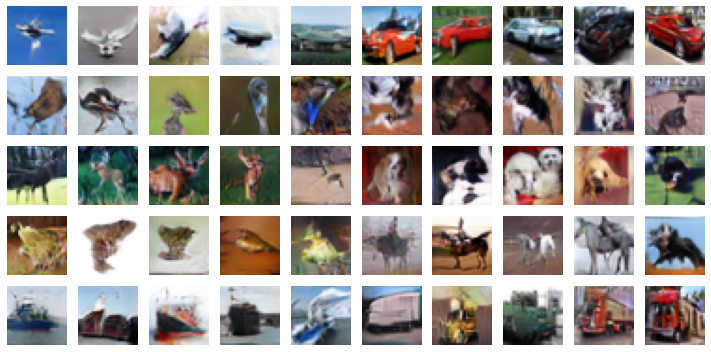

logs {'g_loss_step': tensor(1.1361, device='cuda:0'), 'd_loss_step': tensor(1.8593, device='cuda:0'), 'kid': tensor(0.0116, device='cuda:0'), 'g_loss_epoch': tensor(0.6828, device='cuda:0'), 'd_loss_epoch': tensor(1.6305, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 32, 'kid': tensor(0.0135, device='cuda:0')}


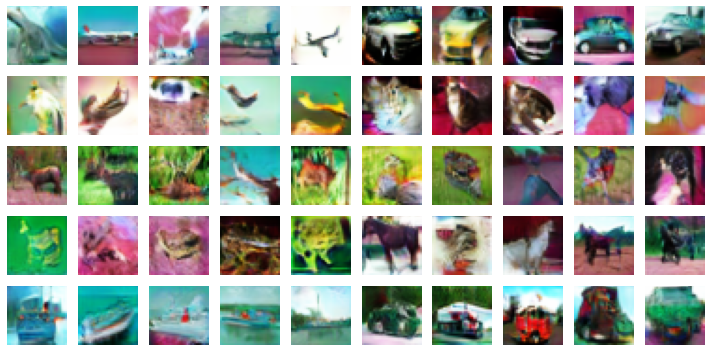

logs {'g_loss_step': tensor(0.5293, device='cuda:0'), 'd_loss_step': tensor(1.7881, device='cuda:0'), 'kid': tensor(0.0135, device='cuda:0'), 'g_loss_epoch': tensor(0.6793, device='cuda:0'), 'd_loss_epoch': tensor(1.6343, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 33, 'kid': tensor(0.0079, device='cuda:0')}


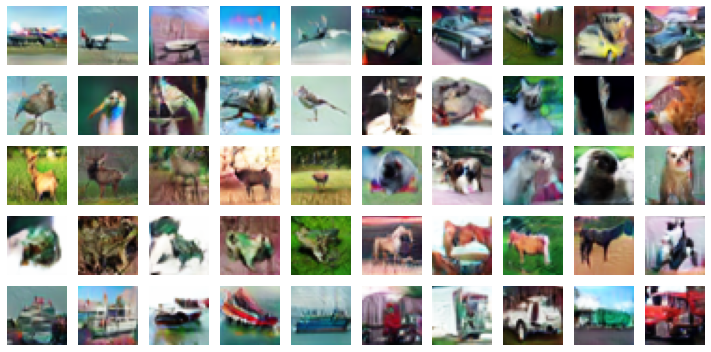

logs {'g_loss_step': tensor(0.0583, device='cuda:0'), 'd_loss_step': tensor(1.8629, device='cuda:0'), 'kid': tensor(0.0079, device='cuda:0'), 'g_loss_epoch': tensor(0.6842, device='cuda:0'), 'd_loss_epoch': tensor(1.6231, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 34, 'kid': tensor(0.0118, device='cuda:0')}


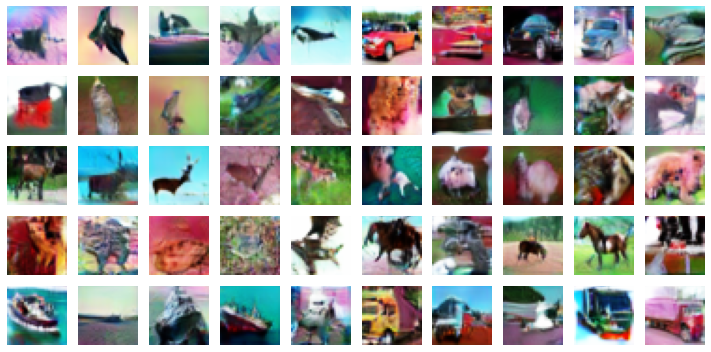

logs {'g_loss_step': tensor(0.3056, device='cuda:0'), 'd_loss_step': tensor(1.8699, device='cuda:0'), 'kid': tensor(0.0118, device='cuda:0'), 'g_loss_epoch': tensor(0.6916, device='cuda:0'), 'd_loss_epoch': tensor(1.6258, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 35, 'kid': tensor(0.0151, device='cuda:0')}


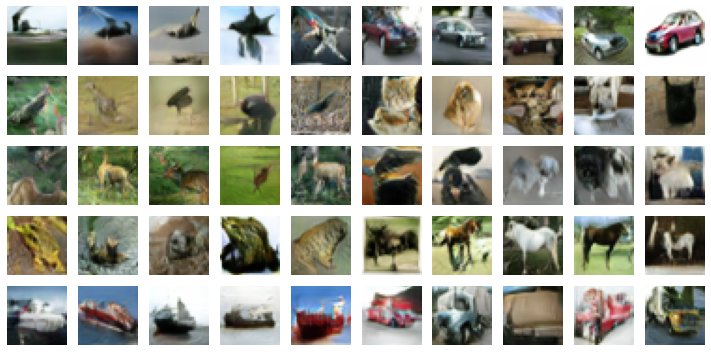

logs {'g_loss_step': tensor(0.5765, device='cuda:0'), 'd_loss_step': tensor(1.6979, device='cuda:0'), 'kid': tensor(0.0151, device='cuda:0'), 'g_loss_epoch': tensor(0.6880, device='cuda:0'), 'd_loss_epoch': tensor(1.6157, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 36, 'kid': tensor(0.0102, device='cuda:0')}


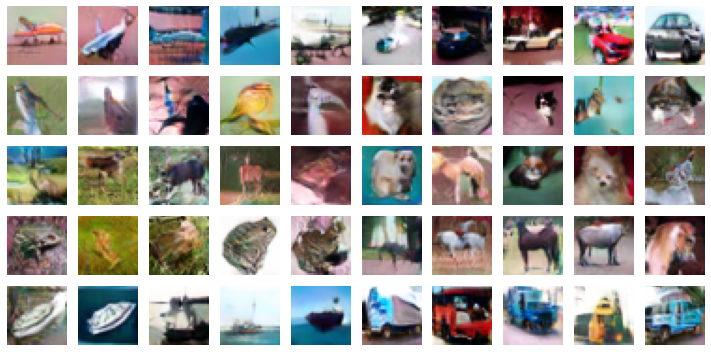

logs {'g_loss_step': tensor(0.4451, device='cuda:0'), 'd_loss_step': tensor(1.8333, device='cuda:0'), 'kid': tensor(0.0102, device='cuda:0'), 'g_loss_epoch': tensor(0.6969, device='cuda:0'), 'd_loss_epoch': tensor(1.6127, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 37, 'kid': tensor(0.0093, device='cuda:0')}


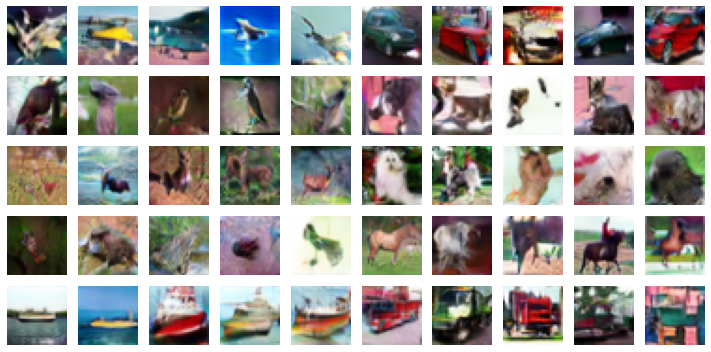

logs {'g_loss_step': tensor(1.4761, device='cuda:0'), 'd_loss_step': tensor(1.8081, device='cuda:0'), 'kid': tensor(0.0093, device='cuda:0'), 'g_loss_epoch': tensor(0.6939, device='cuda:0'), 'd_loss_epoch': tensor(1.6169, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 38, 'kid': tensor(0.0130, device='cuda:0')}


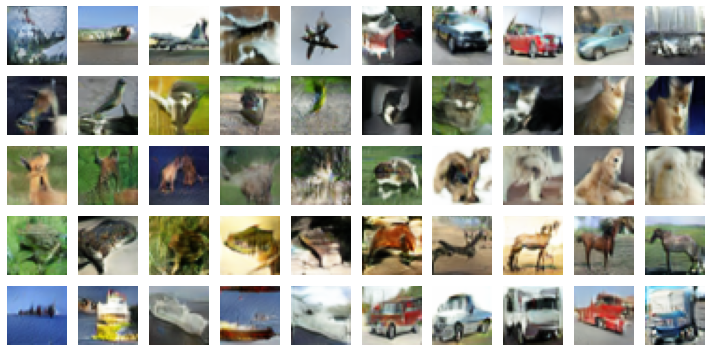

logs {'g_loss_step': tensor(0.6039, device='cuda:0'), 'd_loss_step': tensor(1.6058, device='cuda:0'), 'kid': tensor(0.0130, device='cuda:0'), 'g_loss_epoch': tensor(0.6898, device='cuda:0'), 'd_loss_epoch': tensor(1.6148, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 39, 'kid': tensor(0.0107, device='cuda:0')}


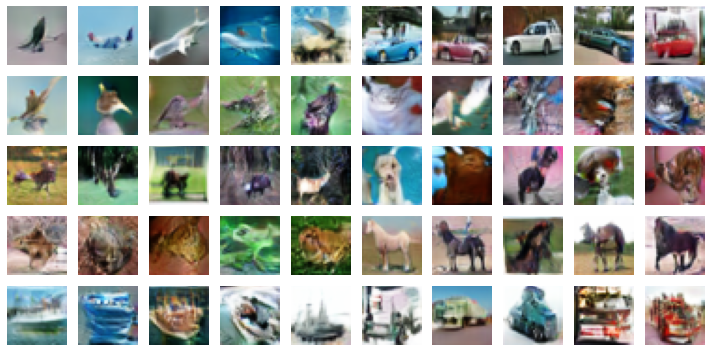

logs {'g_loss_step': tensor(0.8577, device='cuda:0'), 'd_loss_step': tensor(1.5643, device='cuda:0'), 'kid': tensor(0.0107, device='cuda:0'), 'g_loss_epoch': tensor(0.7020, device='cuda:0'), 'd_loss_epoch': tensor(1.6077, device='cuda:0')}


Validation: 0it [00:00, ?it/s]

{'epoch': 40, 'kid': tensor(0.0117, device='cuda:0')}


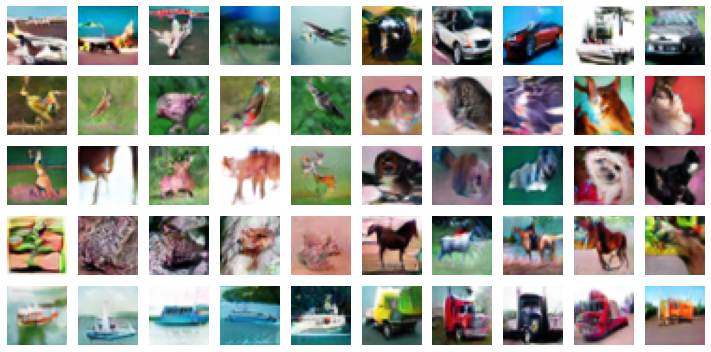

logs {'g_loss_step': tensor(0.4293, device='cuda:0'), 'd_loss_step': tensor(1.6953, device='cuda:0'), 'kid': tensor(0.0117, device='cuda:0'), 'g_loss_epoch': tensor(0.7045, device='cuda:0'), 'd_loss_epoch': tensor(1.6092, device='cuda:0')}


INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=41` reached.


In [ ]:


import wandb
wandb.login(key = '')
wandb.init(project = 'projection discriminator cbn specnorm continue ')

gan = GAN(discriminator = discriminator , generator = generator ,dataloader = train_dataloader  , val_data= test_dataloader,
                        d_loss = hinge_loss , g_loss = generator_loss)
tracker2 = MetricTracker()
trainer = Trainer(gpus=1 , max_epochs  = 41 ,callbacks = [TQDMProgressBar(1) ,tracker2]   , enable_model_summary=False ,num_sanity_val_steps=0,limit_train_batches=1.0, limit_val_batches=1.0)

trainer.fit( gan)

In [ ]:
wrapped_generator = torch_fidelity.GenerativeModelModuleWrapper(generator,128, 'normal', 10)

metrics = torch_fidelity.calculate_metrics(
    input1=wrapped_generator, 
    input2='cifar10-val', 
    input1_model_num_samples = 10000, #size of cifar10 validation set
    cuda=True, 
    isc=False, 
    fid=True, 
    kid=False, 
    verbose=False,
)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting /root/.cache/torch/fidelity_datasets/cifar-10-python.tar.gz to /root/.cache/torch/fidelity_datasets
/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
metrics

{'frechet_inception_distance': 20.355547275371066}

In [ ]:
import pandas as pd
combined = pd.concat((pd.Dataframe(tracker2.collections), pd.DataFrame(tracker.collections)),ignore_index = True)

In [ ]:
import matplotlib.pyplot as plt
def plotlearningcurve(history):
    plt.figure(figsize = (16,9))
    plt.subplot(121)
    plt.plot(history['g_loss'] , label = 'Discriminator Loss')
    plt.plot(history['d_loss'] , label = 'Generator Loss')
    plt.title('Learning Curve - loss')
    plt.ylabel('loss')
    plt.xlabel('Epoch')
    plt.legend( loc='upper left')
    # plt.ylim(bottom = 0 )
    plt.subplot(122)
    plt.plot(history['kid'] , label = 'KID')
    plt.title('Learning Curve - KID')
    plt.ylabel('KID')
    plt.xlabel('Epoch')
    plt.legend( loc='upper left')
    plt.show()

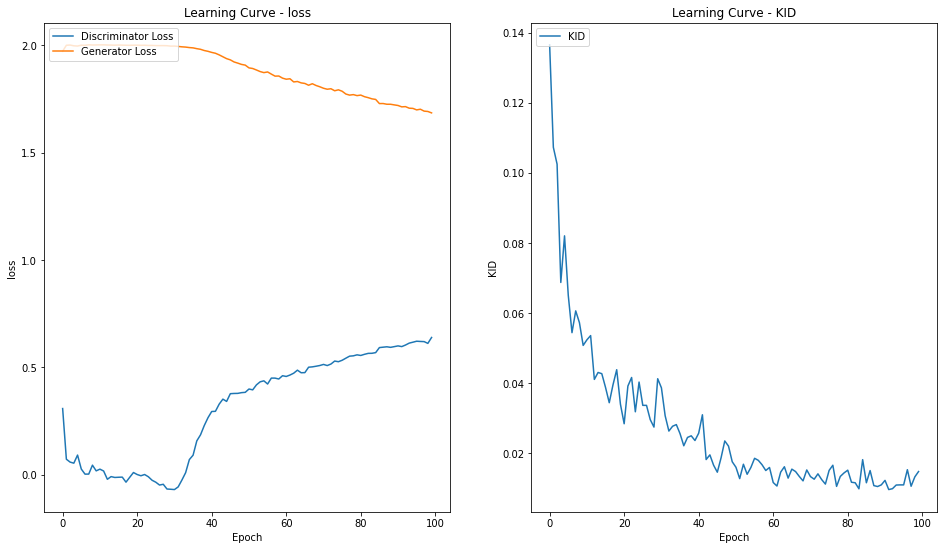

In [ ]:
plotlearningcurve(combined)

- The discriminator loss and generator loss increases  and decreases gradually showing stable training and neither of the networks overpower the other one , showing that the current network architectures are balanced


- The Kernel inception distance decreases  from start of training to around 60 epochs, the kid is stagnent after 60 epoch


- FID score also improved by 10 from the WGAN-GP (20.35)


- Some of the images generated have a pinkish tint to it which makes the images look weird.
- Most of the cifar10 images dont have that color
